In [2]:
# General
import sys
import os
import glob
from time import time
from collections import OrderedDict as od
from importlib import reload
from glob import glob
import itertools

# Scientific
import numpy as np
import pandas as pd
pd.options.display.max_rows = 200
pd.options.display.max_columns = 999
import scipy.io as sio

# Stats
import scipy.stats as stats
import statsmodels.api as sm
import astropy.stats.circstats as circstats
import pycircstat
import random
from sklearn.decomposition import PCA

# Plots
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import matplotlib as mpl
from matplotlib.lines import Line2D
import matplotlib.path as mpath
import matplotlib.patches as patches
mpl.rcParams['grid.linewidth'] = 0.1
mpl.rcParams['grid.alpha'] = 0.75
mpl.rcParams['lines.linewidth'] = 1
mpl.rcParams['lines.markersize'] = 3
mpl.rcParams['xtick.labelsize'] = 15
mpl.rcParams['ytick.labelsize'] = 15 
colors = ['1f77b4', 'd62728', '2ca02c', 'ff7f0e', '9467bd', 
          '8c564b', 'e377c2', '7f7f7f', 'bcbd22', '17becf']
mpl.rcParams['axes.prop_cycle'] = mpl.cycler('color', colors)
mpl.rcParams['axes.spines.right'] = False
mpl.rcParams['axes.spines.top'] = False
mpl.rcParams['axes.formatter.offset_threshold'] = 2
mpl.rcParams['axes.labelsize'] = 17
mpl.rcParams['axes.labelpad'] = 10
mpl.rcParams['axes.titlesize'] = 19
mpl.rcParams['axes.grid'] = False
mpl.rcParams['axes.axisbelow'] = True
mpl.rcParams['legend.loc'] = 'upper right'
mpl.rcParams['legend.fontsize'] = 15
mpl.rcParams['legend.frameon'] = False
mpl.rcParams['figure.dpi'] = 300
mpl.rcParams['figure.titlesize'] = 19
mpl.rcParams['figure.figsize'] = (6.85039, 4.79527) 
mpl.rcParams['figure.subplot.wspace'] = 0.25 
mpl.rcParams['figure.subplot.hspace'] = 0.25 
mpl.rcParams['font.sans-serif'] = ['Helvetica']
mpl.rcParams['savefig.format'] = 'pdf'
mpl.rcParams['pdf.fonttype'] = 42

# Neuro
import mne
from ptsa.data.TimeSeriesX import TimeSeries 
import neurodsp

# Personal
sys.path.append('/home1/dscho/code/general')
sys.path.append('/home1/dscho/code/projects/manning_replication')
sys.path.append('/home1/dscho/code/projects/unit_activity_and_hpc_theta')
import data_io as dio
import array_operations as aop
import spectral_processing as spp
import manning_utils
import manning_analysis
import phase_locking
import lfp_synchrony
import eeg_plotting
from eeg_plotting import plot_trace, plot_trace2

# Colors
n = 4
c = 2
colors = [sns.color_palette('Blues', n)[c], 
          sns.color_palette('Reds', n)[c], 
          sns.color_palette('Greens', n)[c],
          sns.color_palette('Purples', n)[c],
          sns.color_palette('Oranges', n)[c],
          sns.color_palette('Greys', n)[c],
          sns.color_palette('YlOrBr', n+3)[c],
          'k']
cmap = sns.palettes.blend_palette((colors[0], 
                                   sns.palettes.blend_palette((colors[0], 'w', colors[1]), 101)[45],
                                   sns.palettes.blend_palette((colors[0], 'w', colors[1]), 101)[55],
                                   colors[1]), 101)
rdbu_cut = sns.color_palette('RdBu_r', 500)[50:450]

labelfontsize = 12
tickfontsize = 12
figfontsize = 14
labfs = labelfontsize
tickfs = tickfontsize
figfs = figfontsize

/home1/dscho/anaconda3/envs/memlab/lib/python3.6/site-packages/ptsa/data/TimeSeriesX.py:7: DeprecationWarning: importing from ptsa.data.TimeSeries is deprecated; import from ptsa.data.timeseries instead
  DeprecationWarning)


In [156]:
import eeg_plotting
reload(eeg_plotting)

<module 'eeg_plotting' from '/home1/dscho/code/general/eeg_plotting.py'>

In [3]:
def interp_phase(dat, find='peaks', lims=[-np.pi, np.pi], return_uphase=True):
    """Linearly interpolate phase between peaks or troughs.
    
    Parameters
    ----------
    dat : numpy.ndarray
        Bandpass-filtered LFP data with dims channel x time.
    find : str
        'troughs' or 'peaks'.
    lims : list or tuple
        Phase is interpolated between lims[0] and lims[1].
    return_uphase : bool
        If True, unwrapped phase is returned.
        
    Returns
    -------
    cycle_inds : list
        [xvals, yvals] of dat that mark the dividing indices
        between each cycle (i.e. identified peaks or troughs).
    phase : numpy.ndarray
        Wrapped phase values in the same shape as dat.
    phase_unwrapped : numpy.ndarray
        Unwrapped phase values in the same shape as dat.
        Only returned if uphase == True.
    """
    assert len(dat.shape) == 2
    if find == 'troughs':
        comparator = np.less
    elif find == 'peaks':
        comparator = np.greater
    xvals, yvals = signal.argrelextrema(dat, comparator, axis=1)
    cycle_inds = [xvals, yvals]
    if lims[0] == 0:
        phase = -np.ones(dat.shape)
        default_val = -1
    else:
        phase = np.zeros(dat.shape)
        default_val = 0
    phase[xvals, 0] = lims[0]
    phase[xvals, yvals] = lims[1]
    phase[xvals, yvals+1] = lims[0]
    phase = interpolate(phase, default_val)
    
    if return_uphase:
        lim_range = np.abs(lims[1] - lims[0]) / 2
        phase_unwrapped = np.unwrap(phase-lims[0], lim_range)
        return cycle_inds, phase, phase_unwrapped
    else:
        return cycle_inds, phase

def interpolate(arr, default_val=0):
    """Linearly interpolate default_val values.
    
    Parameters
    ----------
    arr : numpy.ndarray
        Any 2D array. Interpolation is done over the
        second axis.
    default_val : int or float
        The value in arr that gets interpolated.
    
    Returns
    -------
    arr : numpy.ndarray
        The interpolated array, with matching
        dimensions to the input array.
    """
    for xind in range(arr.shape[0]):
        keep_inds = np.where(arr[xind, :]!=default_val)[0]
        fill_inds = np.where(arr[xind, :]==default_val)[0]
        f = interp1d(keep_inds, arr[xind, keep_inds], 
                     kind='linear', fill_value='extrapolate')
        arr[xind, fill_inds] = f(fill_inds)
    return arr

def cycles_to_lfp(cycle_stats, arr=None, channel=None, category='power', cycle_type='max'):
    """Return an array that fits a cycle stats category to the shape of the LFP."""
    if arr is not None:
        if channel is None:
            return np.array([np.repeat(arr, cycle_stats[cycle_type]['duration'][channel])
                             for channel in range(len(arr))])
        else:
            return np.repeat(arr, cycle_stats[cycle_type]['duration'][channel])
    else:
        if channel is None:
            return np.array([np.repeat(cycle_stats[cycle_type][category][channel], cycle_stats[cycle_type]['duration'][channel])
                             for channel in range(len(cycle_stats[cycle_type][category]))])
        else:
            return np.repeat(cycle_stats[cycle_type][category][channel], cycle_stats[cycle_type]['duration'][channel])

def convert_radians(vec):
    """Convert from -pi:pi to 0:2pi"""
    return (vec + (2*np.pi)) % (2*np.pi)

def rolling_window(a, window):
    shape = a.shape[:-1] + (a.shape[-1] - window + 1, window)
    strides = a.strides + (a.strides[-1],)
    return np.lib.stride_tricks.as_strided(a, shape=shape, strides=strides)

def rolling_func(arr, f=np.all, window=3, right_fill=None):
    """Divide an array into rolling windows along the -1 axis, 
    and apply a function over the values in each window.
    
    Parameters
    ----------
    arr : numpy.ndarray
        The input array.
    f : function
        The function to apply (must take an axis argument).
    window : int
        The number of values in each window.
        
    Returns
    -------
    numpy.ndarray in the shape of arr if right_fill!=None,
    or with the selected axis equal to its original length
    minus (window-1) if right_fill==None.
    
    Example
    -------
    For arr=np.array([0, 1, 2, 3, 4]), f=np.sum, window=3, right_fill=None:
    
    1) The array is split into windows: [(0, 1, 2), (1, 2, 3), (2, 3, 4)]
    2) We take the sum over each tuple to get the return array: [3, 6, 9]
    3) If right_fill=0 then the return array is [1, 2, 3, 0, 0]
    """
    arr = f(rolling_window(arr, window), axis=-1)
    if right_fill is not None:
        arr = np.append(arr, np.ones(list(arr.shape[:-1]) + [window-1]) * right_fill, axis=-1)
    return arr

In [4]:
def get_subj_df(input_dir='/data3/scratch/dscho/frLfp/data/metadata'):
    """Return subj_df."""
    files = glob.glob(os.path.join(input_dir, 'subj_df_*.xlsx'))
    subj_df = pd.read_excel(files[0], converters={'chan': str})
    for f in files[1:]:
        subj_df = subj_df.append(pd.read_excel(f, converters={'chan': str}))
    subj_df = subj_df.loc[subj_df.location!='none']
    return subj_df

def load_spikes(subj_sess, spike_dir='/data3/scratch/dscho/frLfp/data/spikes'):
    """Return spikes, fr_df, clus_to_chan, chan_to_clus."""
    with open(os.path.join(spike_dir, '{}_session_spikes.pkl'.format(subj_sess)), 'rb') as f:
        spikes = pickle.load(f)
    fr_df, clus_to_chan, chan_to_clus = manning_analysis.get_fr_df(subj_sess, spikes)
    return spikes, fr_df, clus_to_chan, chan_to_clus

def filter_lfp(lfp, l_freq, h_freq):
    """Bandpass filter the LFP using MNE.

    Parameters
    ----------
    lfp : ptsa.data.timeseries.TimeSeries
        An n_channels x n_timepoints TimeSeries of LFP data.
        Coords should be ['channel', 'time', 'samplerate'].
    l_freq : int or float
        Low cut-off frequency in Hz.
    h_freq : int or float
        High cut-off frequency in Hz.

    Returns
    -------
    lfp_filt : ptsa.data.timeseries.TimeSeries
        The filtered LFP data.
    """
    dat = mne.filter.filter_data(np.float64(lfp.copy().data), 
                                 sfreq=lfp.samplerate.data.tolist(), 
                                 l_freq=l_freq, h_freq=h_freq, verbose=False)
    lfp_filt = TimeSeries(dat, name=lfp.name, 
                          dims=['channel', 'time'],
                          coords={'channel': lfp.channel.data,
                                  'time': lfp.time.data,
                                  'samplerate': lfp.samplerate.data.tolist()})
    return lfp_filt

def filter_lfp_bands(lfp, bands, zscore_lfp=False):
    """Bandpass filter the LFP for 1+ bands.

    Parameters
    ----------
    lfp : ptsa.data.timeseries.TimeSeries
        An n_channels x n_timepoints TimeSeries of LFP data.
        Coords should be ['channel', 'time', 'samplerate'].
    bands : dict or OrderedDict
        Keys are the names of each band.
        Values are a list of (low, high) cutoff frequencies in Hz.
    zscore_lfp : bool
        If True, filtered LFP values are Z-scored across time, for each channel.

    Returns
    -------
    lfp_filt : OrderedDict
        Keys are the names of each band.
        Values are TimeSeries objects containing the filtered LFP.
    """
    lfp_filt = OrderedDict()
    for band_name, pass_band in bands.items():
        lfp_filt[band_name] = filter_lfp(lfp, pass_band[0], pass_band[1])
        if zscore_lfp:
            lfp_filt[band_name] = ((lfp_filt[band_name] - lfp_filt[band_name].mean(dim='time')) 
                                   / lfp_filt[band_name].std(dim='time'))
    return lfp_filt

def get_phase_bands(lfp_filt, bands, find='peaks', lims=[-np.pi, np.pi]):
    """Return linearly interpolated phase for each frequency band."""
    phase = OrderedDict()
    for band_name, pass_band in bands.items():
        phase[band_name] = OrderedDict()
        phase[band_name]['inds'], phase[band_name]['phase'] = interp_phase(lfp_filt[band_name].data, 
                                                                           find=find, 
                                                                           lims=lims, 
                                                                           return_uphase=False)
    return phase

def get_hilbert(lfp, zscore_power=False):
    """Return Hilbert-transformed LFP power and phase.

    Parameters
    ----------
    lfp : ptsa.data.timeseries.TimeSeries
        An n_channels x n_timepoints TimeSeries of LFP data.
        Coords should be ['channel', 'time', 'samplerate'].
    zscore_power : bool
        If True, Hilbert transform power values are Z-scored across 
        time, for each channel.

    Returns
    -------
    power : numpy.ndarray
        Power of the complex-valued signal, with dims channel x time.
    phase : numpy.ndarray
        Phase (-np.pi to np.pi) of the complex-valued signal, 
        with dims channel x time.
    """
    info = mne.create_info(ch_names=lfp.channel.values.tolist(), 
                           sfreq=lfp.samplerate.data.tolist(), 
                           ch_types=['seeg']*len(lfp.channel.data))
    lfp_mne = mne.io.RawArray(lfp.copy().data, info, verbose=False)
    lfp_mne.apply_hilbert(envelope=False)
    dat = lfp_mne.get_data()
    power, phase = np.abs(dat), np.angle(dat)

    # Z-score power across time, for each channel.
    if zscore_power:
        power = ((power.T - power.T.mean(axis=0)) / power.T.std(axis=0)).T

    return power, phase

def calc_cycle_stats(cycle_inds, power, pass_band, sampling_rate=2000., 
                     power_percentile=25, osc_length=3):
    """Return cycle-by-cycle statistics for a given frequency band.

    Parameters
    ----------
    cycle_inds : list 
        (x_inds, y_inds) that mark divisions between cycles in the filtered LFP.
    power : numpy.ndarray
        Power of the Hilbert-transformed filtered LFP, with dims channel x time.
    pass_band : list or tuple
        The pass-band of the filtered LFP, with (low, high) cutoffs in Hz.
        Used to determine which cycles are within the pass-band.
    sampling_rate : int or float
        Sampling rate of the LFP.
    power_percentile : int
        Percentile above which the mean power for a given cycle must exceed
        vs. all cycles in a channel (affects cycle_stats['power_mask'],
        cycle_stats['powdur_mask'], cycle_stats['osc_start_mask'], 
        and cycle_stats['osc_mask']).
    osc_length : int
        Number of consectutive cycles that must meet duration and power 
        criteria to be considered an oscillation. A cycle meets duration
        criteria if its duration is within the passband, and meets power
        criteria according to power_percentile.

    Returns
    -------
    cycle_stats : dict
        'power' : mean power for each cycle
        'power_rank' : cycle power rank, taken across time, for each channel
        'power_mask' : mask of power ranks > power_percentile
        'duration' : cycle duration, in number of timepoints
        'duration_hz' : cycle duration, in Hz
        'duration_mask' : mask of cycle durations within the passband
        'powdur_mask' : power_mask * duration_mask
        'osc_start_mask' : cycles at the start of an oscillation (of length=osc_length)
        'osc_mask' : cycles that are part of an oscillation
    """
    cycle_stats = {}
    xinds, yinds = cycle_inds
    cycle_pows = [] # mean power Z-score for each cycle
    cycle_pow_ranks = [] # rank of mean power Z-score for each cycle
    cycle_pow_ma = [] # bool; whether cycle power exceeds the power percentile
    cycle_durs = [] # duration of each cycle, in number of timepoints
    cycle_durs_hz = [] # duration of each cycle, in Hz
    cycle_durs_ma = [] # bool; whether cycle length is within the passband
    cycle_powdur_ma = [] # bool; cycle_durs_ma * cycle_pow_ma
    cycle_osc_start_ma = [] # bool; cycles at the start of an oscillation (of length = osc_length)
    cycle_osc_ma = [] # bool; cycles that are part of an oscillation
    for xind in np.unique(xinds):
        yinds_ = yinds[xinds==xind]

        # Get mean Z-power and ranked power for each cycle.
        split_pows = np.split(power[xind, :], yinds_)
        cycle_pows.append(np.array([np.mean(arr) for arr in split_pows]))
        xsort = cycle_pows[-1].argsort()
        cycle_pow_ranks_ = np.empty(xsort.shape)
        cycle_pow_ranks_[xsort] = np.arange(len(cycle_pow_ranks_))
        cycle_pow_ranks.append(cycle_pow_ranks_)

        # Get duration (in timepoints and Hz) for each cycle.
        cycle_durs.append(np.array([len(arr) for arr in split_pows]))
        cycle_durs_hz.append(np.array([sampling_rate / len(arr) for arr in split_pows]))

        # Mask cycles according to power and duration criteria.
        cycle_pow_ma.append(cycle_pow_ranks_ > np.percentile(cycle_pow_ranks_, power_percentile))
        cycle_durs_ma.append((cycle_durs_hz[-1] > pass_band[0]) * (cycle_durs_hz[-1] < pass_band[1]))
        cycle_powdur_ma.append(cycle_durs_ma[-1] * cycle_pow_ma[-1])

        # Get oscillation masks.
        cycle_osc_start_ma.append(rolling_func(cycle_powdur_ma[-1], np.all, window=osc_length, right_fill=False))
        osc_cycles = np.zeros(len(cycle_osc_start_ma[-1]), dtype=np.bool_)
        osc_starts = np.where(cycle_osc_start_ma[-1])[0]
        for i in range(osc_length):
            osc_cycles[osc_starts+i] = True
        cycle_osc_ma.append(osc_cycles)

    cycle_stats = {'power': cycle_pows,
                   'power_rank': cycle_pow_ranks,
                   'power_mask': cycle_pow_ma,
                   'duration': cycle_durs,
                   'duration_hz': cycle_durs_hz,
                   'duration_mask': cycle_durs_ma,
                   'powdur_mask': cycle_powdur_ma,
                   'osc_start_mask': cycle_osc_start_ma,
                   'osc_mask': cycle_osc_ma}

    return cycle_stats

def save_pickle(obj, fpath, verbose=True):
    """Save object as a pickle file."""
    with open(fpath, 'wb') as f:
        pickle.dump(obj, f, pickle.HIGHEST_PROTOCOL)
    if verbose:
        print('Saved {}'.format(fpath))
        
def open_pickle(fpath):
    """Return object."""
    with open(fpath, 'rb') as f:
        obj = pickle.load(f)
    return obj

In [5]:
def get_cycle_stats(subj_sess,
                    bands=None,
                    interp_spikes=True,
                    notch_freqs=[60, 120],
                    zscore_lfp=True,
                    zscore_power=True,
                    phase_type='peaks', # troughs, peaks, or hilbert
                    power_percentile=25,
                    osc_length=3,
                    save_outputs=True,
                    output_dir='/scratch/dscho/phase_precession/data/cycle_stats'):
    """Calculate phase, power, and cycle-by-cycle stats for bandpass-filtered LFPs.
    
    Cycles are determined by finding peaks or troughs in the filtered LFPs 
    (positive-to-negative or negative-to-positive derivatives, respectively).
    
    Parameters
    ----------
    bands : OrderedDict()
        LFP bands to filter. Default bands are:
            low_theta (1-5 Hz)
            high_theta (5-10 Hz)
            alpha_beta (10-20 Hz)
            low_gamma (30-50 Hz)
            mid_gamma (70-90 Hz)
            high_gamma (90-110 Hz)
    subj_sess : str
        e.g. 'U367_env2'
    interp_spikes : bool
        If True, spikes for each unit are removed from the preprocessed
        LFP by linear interpolation (-2 to 4ms surrounding each spike).
    notch_freqs : list
        Frequencies at which to notch-filter the LFP data during
        preprocessing. If notch_freqs=[] then no notch filtering is done.
    zscore_lfp : bool
        If True, filtered LFP values are Z-scored across time, for each channel.
    zscore_power : bool
        If True, Hilbert transform power values for filtered LFPs are
        Z-scored across time, for each channel.
    phase_type : str
        'peaks' to return phase values that are linearly interpolated
            (0 to 2pi) between identified peaks in the filtered LFPs.
        'troughs' to return phase values that are linearly interpolated
            (0 to 2pi) between identified troughs in the filtered LFPs.
        'hilbert' to return phase from the Hilbert transform of filtered
            LFPs. NOTE if 'hilbert' is chosen then cycle_stats are
            calculated between peaks in the filtered LFPs.
    power_percentile : int
        Percentile above which the mean power for a given cycle must exceed
        vs. all cycles in a channel (affects cycle_stats['power_mask'],
        cycle_stats['powdur_mask'], cycle_stats['osc_start_mask'], 
        and cycle_stats['osc_mask']).
    osc_length : int
        Number of consectutive cycles that must meet duration and power 
        criteria to be considered an oscillation. A cycle meets duration
        criteria if its duration is within the passband, and meets power
        criteria according to power_percentile.
    save_files : bool
        If True, cycle_stats is saved to the path hard-coded into this function.
    output_dir : bool
        Directory where cycle_stats is saved.
        
    Returns
    -------
    lfp_filt : OrderedDict() of ptsa.data.timeseries.TimeSeries
        Keys are the a priori frequency bands.
        Values are TimeSeries objects of the channel x time
        bandpass-filtered LFPs.
    phase : OrderedDict() of OrderedDict()
        Keys are the a priori frequency bands.
        Nested keys:
            'inds' : [xinds, yinds] identifying breaks between cycles
                in the filtered LFPs, where x refers to channel and y to time.
            'phase' : channel x time phase values by the method specified
                in phase_type.
    power : OrderedDict() of numpy.ndarray
        Keys are the a priori frequency bands.
        Values are channel x time power values from Hilbert transform
        of the filtered LFPs.
    cycle_stats : OrderedDict() of dict
        Keys are the a priori frequency bands.
        Nested keys:
            'power' : mean power for each cycle
            'power_rank' : cycle power rank, taken across time, for each channel
            'power_mask' : mask of power ranks > power_percentile
            'duration' : cycle duration, in number of timepoints
            'duration_hz' : cycle duration, in Hz
            'duration_mask' : mask of cycle durations within the passband
            'powdur_mask' : power_mask * duration_mask
            'osc_start_mask' : cycles at the start of an oscillation (of length=osc_length)
            'osc_mask' : cycles that are part of an oscillation
    """
    if bands is None:
        bands = OrderedDict([('low_theta', [1, 5]),
                             ('high_theta', [5, 10]),
                             ('alpha_beta', [10, 20]),
                             ('low_gamma', [30, 50]),
                             ('mid_gamma', [70, 90]),
                             ('high_gamma', [90, 110])])
    hpc_rois = ['LAH', 'LMH', 'LPH', 'RAH', 'RMH', 'RPH']
    
    # Get session info.
    subj_df = get_subj_df()
    
    # Load spikes.
    spikes, fr_df, clus_to_chan, chan_to_clus = load_spikes(subj_sess)

    # Load the raw LFP.
    lfp_raw, lfp_preproc = manning_analysis.process_lfp(subj_sess, 
                                                        subj_df=subj_df, 
                                                        notch_freqs=notch_freqs,
                                                        interpolate=interp_spikes,
                                                        session_spikes=spikes,
                                                        ms_before=2,
                                                        ms_after=4)
    sampling_rate = lfp_preproc.samplerate.data.tolist()
    
    # Bandpass filter the LFP.
    lfp_filt = filter_lfp_bands(lfp_preproc, 
                                bands=bands, 
                                zscore_lfp=zscore_lfp)
    
    # Use a derivative test to identify troughs and peaks in the filtered 
    # LFP, then linearly interpolate phase between cycles.
    if phase_type == 'hilbert':
        phase_type_ = 'peaks'
    else:
        phase_type_ = phase_type
    
    phase = get_phase_bands(lfp_filt, 
                            bands=bands, 
                            find=phase_type_, 
                            lims=[-np.pi, np.pi])
        
    # Get Hilbert transform of the LFP and derive mean power for each cycle.
    power = OrderedDict()
    for band_name, pass_band in bands.items():
        power[band_name], phase_hilbert = get_hilbert(lfp_filt[band_name], 
                                                      zscore_power=zscore_power)
        if phase_type == 'hilbert':
            phase[band_name]['phase'] = phase_hilbert
            
    # For each channel, get the mean power and duration of each cycle.
    cycle_stats = OrderedDict()
    for band_name, pass_band in bands.items():
        cycle_stats[band_name] = calc_cycle_stats(phase[band_name]['inds'], 
                                                  power=power[band_name], 
                                                  pass_band=pass_band, 
                                                  sampling_rate=sampling_rate, 
                                                  power_percentile=power_percentile, 
                                                  osc_length=osc_length)
        
    if save_outputs:
        fpath = os.path.join(output_dir, '{}_cycle_stats_{}_{}powpct_{}osclength.pkl'
                             .format(subj_sess, phase_type_, power_percentile, osc_length))
        save_pickle(cycle_stats, fpath)
        
    return lfp_filt, phase, power, cycle_stats

def calc_phase_locking_bands(subj_sess,
                             bands=None,
                             interp_spikes=True,
                             notch_freqs=[60, 120],
                             zscore_lfp=True,
                             zscore_power=True,
                             phase_type='peaks', # troughs, peaks, or hilbert
                             power_percentile=25,
                             osc_length=3,
                             mask_type=None,
                             save_outputs=True,
                             output_dir='/scratch/dscho/phase_precession/data/phase_locking'):
    """Calculate phase-locking to bandpass filtered LFPs.
    
    Parameters
    ----------
    subj_sess : str
        e.g. 'U367_env2'
    bands : OrderedDict()
        LFP bands to filter. Default bands are:
            low_theta (1-5 Hz)
            high_theta (5-10 Hz)
            alpha_beta (10-20 Hz)
            low_gamma (30-50 Hz)
            mid_gamma (70-90 Hz)
            high_gamma (90-110 Hz)
    interp_spikes : bool
        If True, spikes for each unit are removed from the preprocessed
        LFP by linear interpolation (-2 to 4ms surrounding each spike).
    notch_freqs : list
        Frequencies at which to notch-filter the LFP data during
        preprocessing. If notch_freqs=[] then no notch filtering is done.
    zscore_lfp : bool
        If True, filtered LFP values are Z-scored across time, for each channel.
    zscore_power : bool
        If True, Hilbert transform power values for filtered LFPs are
        Z-scored across time, for each channel.
    phase_type : str
        'peaks' to return phase values that are linearly interpolated
            (0 to 2pi) between identified peaks in the filtered LFPs.
        'troughs' to return phase values that are linearly interpolated
            (0 to 2pi) between identified troughs in the filtered LFPs.
        'hilbert' to return phase from the Hilbert transform of filtered
            LFPs. NOTE if 'hilbert' is chosen then cycle_stats are
            calculated between peaks in the filtered LFPs.
    power_percentile : int
        Percentile above which the mean power for a given cycle must exceed
        vs. all cycles in a channel (affects cycle_stats['power_mask'],
        cycle_stats['powdur_mask'], cycle_stats['osc_start_mask'], 
        and cycle_stats['osc_mask']).
    osc_length : int
        Number of consectutive cycles that must meet duration and power 
        criteria to be considered an oscillation. A cycle meets duration
        criteria if its duration is within the passband, and meets power
        criteria according to power_percentile.
    mask_type : str
        cycle_stats field to use for masking out spikes from phase-locking
        calculations. 'power_mask', 'duration_mask', 'powdur_mask', 
        'osc_start_mask', or 'osc_mask'. If mask_type is None then all spikes
        are included.
    save_files : bool
        If True, pl_df is saved to the filename coded into this function.
    output_dir : bool
        Directory where pl_df is saved.
        
    Returns
    -------
    pl_df : pandas.DataFrame
        Phase-locking data for each unit in the session (including phases of
        all spikes included in the analysis for each unit).
    """
    if bands is None:
        bands = OrderedDict([('low_theta', [1, 5]),
                             ('high_theta', [5, 10]),
                             ('alpha_beta', [10, 20]),
                             ('low_gamma', [30, 50]),
                             ('mid_gamma', [70, 90]),
                             ('high_gamma', [90, 110])])
    hpc_rois = ['LAH', 'LMH', 'LPH', 'RAH', 'RMH', 'RPH']
    
    # Get session info.
    subj_df = get_subj_df()
    
    # Load spikes.
    spikes, fr_df, clus_to_chan, chan_to_clus = load_spikes(subj_sess)

    # Load the raw LFP.
    lfp_raw, lfp_preproc = manning_analysis.process_lfp(subj_sess, 
                                                        subj_df=subj_df, 
                                                        notch_freqs=notch_freqs,
                                                        interpolate=interp_spikes,
                                                        session_spikes=spikes,
                                                        ms_before=2,
                                                        ms_after=4)
    sampling_rate = lfp_preproc.samplerate.data.tolist()
    
    # Bandpass filter the LFP.
    lfp_filt = filter_lfp_bands(lfp_preproc, 
                                bands=bands, 
                                zscore_lfp=zscore_lfp)
    
    # Use a derivative test to identify troughs and peaks in the filtered 
    # LFP, then linearly interpolate phase between cycles.
    if phase_type == 'hilbert':
        phase_type_ = 'peaks'
    else:
        phase_type_ = phase_type
    
    phase = get_phase_bands(lfp_filt, 
                            bands=bands, 
                            find=phase_type_, 
                            lims=[-np.pi, np.pi])
        
    # Get Hilbert transform phase (instead of linearly interpolated phase).
    if phase_type == 'hilbert':
        for band_name, pass_band in bands.items():
            _, phase_hilbert = get_hilbert(lfp_filt[band_name])
            phase[band_name]['phase'] = phase_hilbert
    
    # Load cycle_stats
    cycle_stats = open_pickle(os.path.join('/scratch/dscho/phase_precession/data/cycle_stats',
                                           '{}_cycle_stats_{}_{}powpct_{}osclength.pkl'
                                           .format(subj_sess, phase_type_, power_percentile, osc_length)))
    
    # Get phase mask.
    if mask_type is not None:
        mask = OrderedDict()
        for band_name, pass_band in bands.items():
            mask[band_name] = cycles_to_lfp(cycle_stats, category=mask_type, cycle_type=band_name)
    
    output = []
    col_names = ['subj_sess', 'unit', 'chan', 'hem', 'roi', 'hemroi', 'is_hpc', 
                 'phases', 'means', 'lengths', 'pvals']
    hpc_rois = ['LAH', 'LMH', 'LPH', 'RAH', 'RMH', 'RPH']
    for unit in units:
        spike_train = fr_df.loc[unit, 'spikes']
        chan = fr_df.at[unit, 'chan']
        chan_ind = int(chan) - 1
        hemroi = fr_df.at[unit, 'location']
        hem = hemroi[0]
        roi = hemroi[1:]
        is_hpc = hemroi in hpc_rois

        # Get phase and phase stats for each band.
        spike_phases = []
        means = []
        lengths = []
        pvals = []
        for band_name, pass_band in bands.items():
            if mask_type is None:
                spike_inds = np.where(spike_train)[0]
            else:
                spike_inds = np.where(mask[band_name][chan_ind, :] * spike_train)[0]
            spike_phases_ = phase[band_name]['phase'][chan_ind, spike_inds]
            if len(spike_phases_) > 0:
                spike_phases.append(spike_phases_)
                mean, length = circstats.circmoment(spike_phases_)
                means.append(mean)
                lengths.append(length)
                pvals.append(circstats.rayleightest(spike_phases_))       

        # Add values for the unit to the output list
        output.append([subj_sess, unit, chan, hem, roi, hemroi, is_hpc, 
                       spike_phases, np.array(means), np.array(lengths), np.array(pvals)])

    # Covert output list to DataFrame format.
    pl_df = pd.DataFrame(output, columns=col_names)
    
    # Save the phase-locking DataFrame.
    if mask_type is None:
        mask_type = 'no_mask'
    if save_outputs:
        fpath = os.path.join(output_dir, '{}_phase_locking_df_{}_{}_{}powpct_{}osclength.pkl'
                             .format(subj_sess, mask_type, phase_type_, power_percentile, osc_length))
        save_pickle(pl_df, fpath)
        
    return pl_df

## Cycle stats

In [9]:
# Instantiate LFP bands.
bands = od([('low_theta', [1, 5]),
            ('high_theta', [5, 10]),
            ('alpha_beta', [10, 20]),
            ('low_gamma', [30, 50]),
            ('mid_gamma', [70, 90]),
            ('high_gamma', [90, 110])])
bands_fancy = {'low_theta': 'Low theta (1-5 Hz)',
               'high_theta': 'High theta (5-10 Hz)',
               'alpha_beta': 'Alpha-beta (10-20 Hz)',
               'low_gamma': 'Low gamma (30-50 Hz)',
               'mid_gamma': 'Mid gamma (70-90 Hz)',
               'high_gamma': 'High gamma (90-110 Hz)'}

bands = od([('theta', [4, 8])])

In [10]:
# Get a list of sessions to include in the analysis.
sessions = ['U387_ses3', 'U369_env1', 'U372_ses2', 'U390_ses3', 
            'U369_env2', 'U373_ses1', 'U387_ses1', 'U380_ses2', 
            'U393_ses2', 'U395_ses2', 'U384_ses3', 'U385_ses4', 
            'U371_env2', 'U371_env3']
sessions = np.sort(sessions)
sessions

array(['U369_env1', 'U369_env2', 'U371_env2', 'U371_env3', 'U372_ses2',
       'U373_ses1', 'U380_ses2', 'U384_ses3', 'U385_ses4', 'U387_ses1',
       'U387_ses3', 'U390_ses3', 'U393_ses2', 'U395_ses2'], dtype='<U9')

In [9]:
# Get a list of sessions that need to be processed.
cycle_stat_files = glob.glob('/scratch/dscho/phase_precession/data/cycle_stats/*.pkl')
processed_sessions = [os.path.basename(f)[:9] for f in cycle_stat_files if os.path.basename(f)[:9]]
sessions_to_process = [subj for subj in sessions if subj not in processed_sessions]
sessions_to_process

[]

In [11]:
sessions_to_process = ['U385_ses4']

In [11]:
# Process each session in serial (and save cycle_stats data).
for subj_sess in sessions_to_process:
    start_time = time()
    lfp_filt, phase, power, cycle_stats = phase_locking.get_cycle_stats(subj_sess, bands=bands, phase_type='peaks', save_outputs=False)
    print('Done in {:.0f} secs'.format(time() - start_time))

Done in 72 secs


In [14]:
# Piecemeal code...
start_time = time()

# Instantiate LFP bands.
bands = od([('theta', [4, 8])])

subj_sess = 'U385_ses4' #'U387_ses3'
subj_df = phase_locking.get_subj_df()
spikes, fr_df, clus_to_chan, chan_to_clus = phase_locking.load_spikes(subj_sess)
lfp_raw, lfp_preproc = manning_analysis.process_lfp(subj_sess, 
                                                    subj_df=subj_df, 
                                                    notch_freqs=[60, 120, 180],
                                                    interpolate=False,
                                                    session_spikes=spikes)
lfp_filt = phase_locking.filter_lfp_bands(lfp_preproc, bands, zscore_lfp=False)

print('Done in {:.0f} secs'.format(time() - start_time))

Done in 22 secs


In [46]:
start_time = time()
lfp_filt = get_cycle_stats(subj_sess, bands=bands)
print('Done in {:.0f} secs'.format(time() - start_time))

Done in 190 secs


In [54]:
start_time = time()
phase = get_phase_bands(lfp_filt, 
                        bands=bands, 
                        find='peaks')
print('Done in {:.0f} secs'.format(time() - start_time))

Done in 237 secs


In [106]:
start_time = time()
power = OrderedDict()
for band_name, pass_band in bands.items():
    power[band_name], phase_hilbert = get_hilbert(lfp_filt[band_name], 
                                                  zscore_power=True)
print('Done in {:.0f} secs'.format(time() - start_time))

Done in 394 secs


In [112]:
start_time = time()
cycle_stats = OrderedDict()
for band_name, pass_band in bands.items():
    cycle_stats[band_name] = calc_cycle_stats(phase[band_name]['inds'], 
                                              power=power[band_name], 
                                              pass_band=pass_band, 
                                              sampling_rate=2000., 
                                              power_percentile=25, 
                                              osc_length=3)
print('Done in {:.0f} secs'.format(time() - start_time))

Done in 488 secs


In [126]:
start_time = time()
output_dir = '/scratch/dscho/phase_precession/data/cycle_stats'
fpath = os.path.join(output_dir, '{}_cycle_stats_{}_{}powpct_{}osclength.pkl'
                     .format(subj_sess, 'peaks', 25, 3))
save_pickle(cycle_stats, fpath)
print('Done in {:.0f} secs'.format(time() - start_time))

Saved /scratch/dscho/phase_precession/data/cycle_stats/U387_ses1_cycle_stats_peaks_25powpct_3osclength.pkl
Done in 14 secs


In [7]:
lfp_filt = manning_analysis.preprocess_session()

## Plots 1

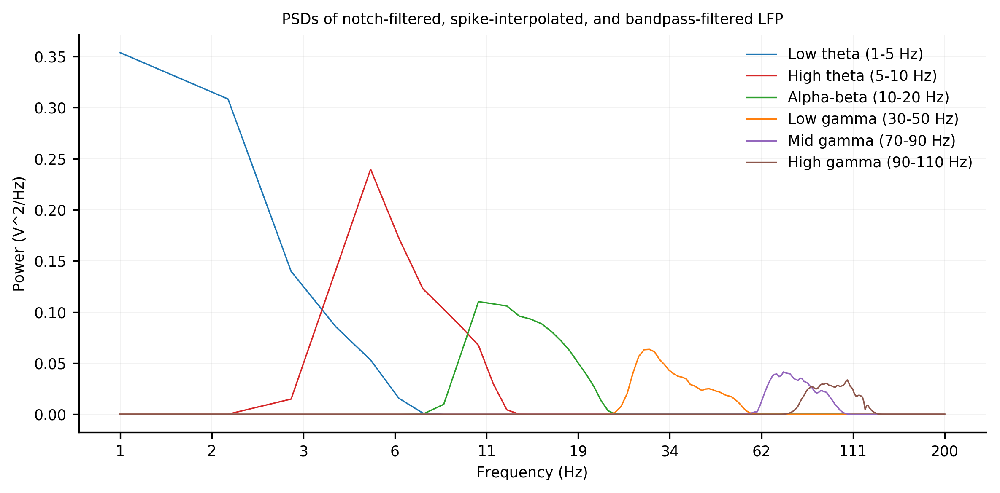

In [135]:
freq_means = OrderedDict()
P_means = OrderedDict()
i = 40
for band_name in bands.keys():
    freq_means[band_name], P_means[band_name] = neurodsp.spectral.psd(lfp_filt[band_name][i, :], Fs=2000)

fig, ax = plt.subplots(1, 1, figsize=(8, 4), dpi=300)
ax = np.ravel(ax)

for band_name in bands.keys():
    ax[0].plot(np.log10(freq_means[band_name][1:201]), P_means[band_name][1:201], label=bands_fancy[band_name])
ax[0].set_xticks(np.linspace(np.log10(1), np.log10(200), 10))
ax[0].set_xticklabels([int(round(10**x, 0)) for x in np.linspace(np.log10(1), np.log10(200), 10)])
ax[0].set_xlabel('Frequency (Hz)')
ax[0].set_ylabel('Power (V^2/Hz)')
ax[0].legend()
ax[0].set_title('PSDs of notch-filtered, spike-interpolated, and bandpass-filtered LFP')
fig.tight_layout()

In [16]:
lfp_filt['high_theta']

dict_keys(['power', 'power_rank', 'power_mask', 'duration', 'duration_hz', 'duration_mask', 'powdur_mask', 'osc_start_mask', 'osc_mask'])

In [ ]:
subj_df.head

In [171]:
# Piecemeal code...
start_time = time()

# Instantiate LFP bands.
bands = od([('theta', [3, 8])])

subj_sess = 'U385_ses4' #'U387_ses3'
subj_df = phase_locking.get_subj_df()
spikes, fr_df, clus_to_chan, chan_to_clus = phase_locking.load_spikes(subj_sess)
lfp_raw, lfp_preproc = manning_analysis.process_lfp(subj_sess, 
                                                    subj_df=subj_df, 
                                                    notch_freqs=[60, 120, 180],
                                                    interpolate=False,
                                                    session_spikes=spikes)
lfp_filt = phase_locking.filter_lfp_bands(lfp_preproc.sel(channel=['1']), bands, zscore_lfp=False)

print('Done in {:.0f} secs'.format(time() - start_time))

Done in 16 secs


In [86]:
# 76000
np.vstack((lfp_filt['theta'][:1, :] * 1e6,
           (lfp_preproc[:1, :] - np.mean(lfp_preproc[:1, :])) * 1e6))

array([[ 1.52465931e-14,  3.25319317e-01,  6.50441165e-01, ...,
         2.50058936e+00,  1.25040041e+00, -6.77626358e-15],
       [-1.68340046e+02, -1.63899561e+02, -1.70142867e+02, ...,
         3.83259804e+01,  3.17314652e+01,  3.30387576e+01]])

(<Figure size 3600x1200 with 1 Axes>,
 array([<matplotlib.axes._subplots.AxesSubplot object at 0x2b364c5193c8>],
       dtype=object))

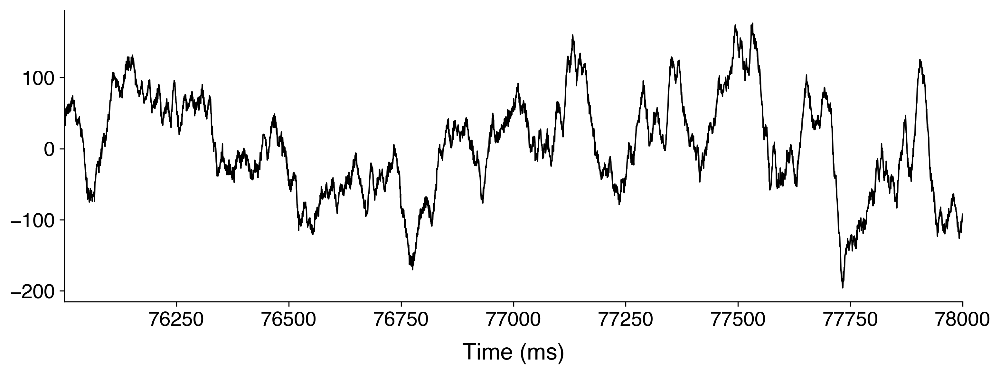

In [85]:
i = 20
plot_trace((lfp_preproc[:1, :] - np.mean(lfp_preproc[:1, :])) * 1e6, start=76000, duration=2000, x_units='ms', 
           colors=['k'], linewidths=[1], dpi=300)

In [10]:
# Inches for 1, 1.5, and 2 column width.
colws = od([(1, 3.34646), (1.5, 4.48819), (2, 6.85039)])

In [28]:
dat.shape[0]

2

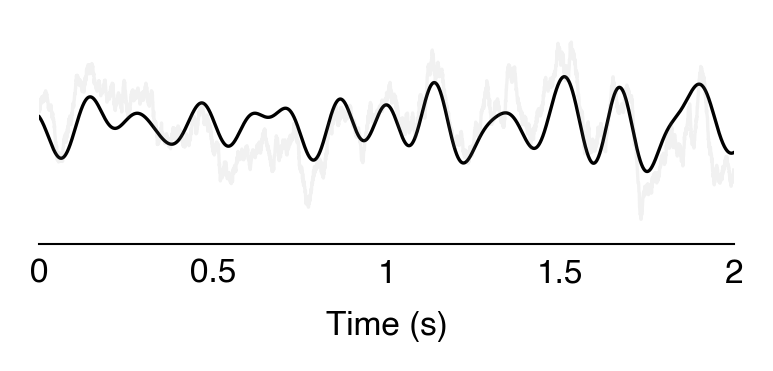

In [62]:
fig, ax = plt.subplots(1, 1, figsize=[colws[1]*0.8, colws[1]*0.8*0.5], dpi=300)
ax = np.ravel(ax)

tickfontsize = 8
labelfontsize = 8

start, duration = 152000, 4000
dat = np.vstack((lfp_filt['theta'][:1, start:start+duration] - np.mean(lfp_filt['theta'][:1, start:start+duration]),
                 lfp_preproc[:1, start:start+duration] - np.mean(lfp_preproc[:1, start:start+duration])))
dat *= 1e6

colors_ = ['k', colors[5]]
alphas = [1, 0.1]
linewidths = [0.8, 0.8]


i = 0
for iLine in range(dat.shape[0]):
    ax[i].plot(dat[iLine, :], color=colors_[iLine], alpha=alphas[iLine], linewidth=linewidths[iLine])
# fig, ax = plot_trace(, 
#                      start=start, duration=duration, x_units='ms', 
#                      colors=['k', colors[5]], alphas=[1, 0.2], linewidths=[0.8, 0.6], 
#                      dpi=300, figsize=[colws[1], colws[1]*0.4])


ax[i].set_xlim([0, duration])
ax[i].set_xticks(np.linspace(0, duration, 5))
ax[i].set_xticklabels([0, 0.5, 1, 1.5, 2], fontsize=tickfontsize)
ax[i].set_xlabel('Time (s)', fontsize=labelfontsize, labelpad=5)
ax[i].set_ylim([-250, 200])
ax[i].set_yticks(np.linspace(-200, 200, 3))
ax[i].set_yticklabels(np.linspace(-200, 200, 3, dtype=int), fontsize=tickfontsize)
ax[i].set_ylabel('μV', fontsize=labelfontsize, labelpad=0)
for axis in ['top','bottom','left','right']:
    ax[i].spines[axis].set_linewidth(0.5)
ax[i].tick_params(width=0.5, length=0)
ax[i].axes.get_yaxis().set_visible(False)
ax[i].spines['left'].set_visible(False)

fig.tight_layout()

if False:
    fig.savefig('/home1/dscho/projects/unit_activity_and_hpc_theta/figs/example_hpc_theta_trace_2sec_U385_ses4_chan1.pdf', 
                format='pdf', bbox_inches='tight')
    fig.savefig('/home1/dscho/projects/unit_activity_and_hpc_theta/figs/example_hpc_theta_trace_2sec_U385_ses4_chan1.png', 
                format='png', dpi=300, bbox_inches='tight')

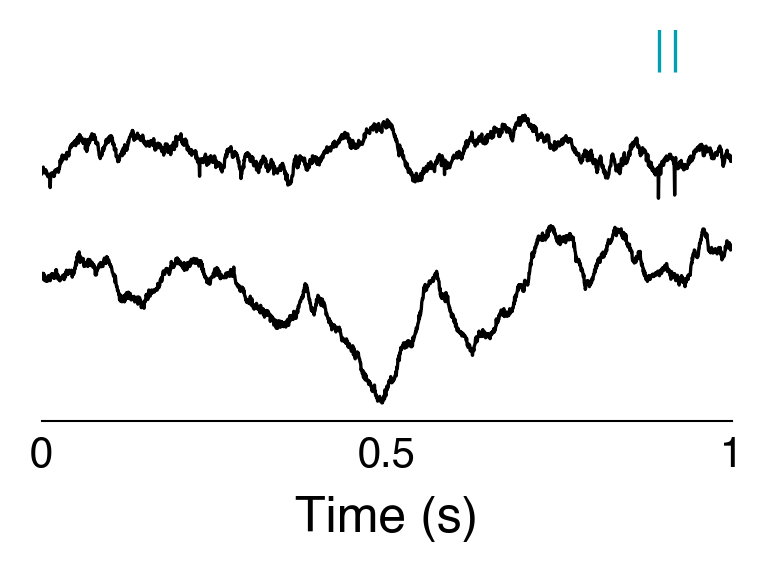

In [222]:
fig, ax = plt.subplots(1, 1, figsize=[colws[1]*0.8, colws[1]*0.8*0.75], dpi=300)
ax = np.ravel(ax)

tickfontsize = 10
labelfontsize = 12
colors_ = ['#f37735', '#00a0b0']

iChans = [20, 24]

# start, duration = 180000, 2000
start, duration = 197200, 2000
dat = np.vstack((lfp_preproc[iChans[0]:iChans[0]+1, start:start+duration] - np.mean(lfp_preproc[iChans[0]:iChans[0]+1, start:start+duration]),
                 lfp_preproc[iChans[1]:iChans[1]+1, start:start+duration] - np.mean(lfp_preproc[iChans[1]:iChans[1]+1, start:start+duration])))
dat *= 1e6
dat[0, :] = dat[0, :] + 400

i = 0
for iLine in range(dat.shape[0]):
    ax[i].plot(dat[iLine, :], color='k', alpha=1, linewidth=0.8)
    if iLine == 0:
        for iUnit in range(1, 2):
            spike_inds = np.where(fr_df.query("(chan=='{}')".format(iChans[0]+1)).iloc[iUnit]['spikes'])[0]
            spike_inds[(spike_inds>=197200) & (spike_inds<199200)]
            spike_vec = np.zeros(2000)
            spike_vec[spike_vec==0] = np.nan
            spike_vec[spike_inds[(spike_inds>=197200) & (spike_inds<199200)] - 197200] = 700
            ax[i].plot(spike_vec, marker='|', markerfacecolor=colors_[iUnit], markeredgecolor=colors_[iUnit], 
                       linewidth=0, alpha=1, markeredgewidth=0.8, markersize=12)
    ax[i].set_xlim([0, duration])
    ax[i].set_xticks(np.linspace(0, duration, 3))
    ax[i].set_xticklabels([0, 0.5, 1], fontsize=tickfontsize)
    ax[i].set_xlabel('Time (s)', fontsize=labelfontsize, labelpad=5)
#     ax[i].set_ylim([-200, 400])
    ax[i].set_yticks(np.linspace(-200, 200, 3))
    ax[i].set_yticklabels(np.linspace(-200, 200, 3, dtype=int), fontsize=tickfontsize)
    ax[i].set_ylabel('μV', fontsize=labelfontsize, labelpad=0)
    for axis in ['top','bottom','left','right']:
        ax[i].spines[axis].set_linewidth(0.5)
    ax[i].tick_params(width=0.5, length=0)
    ax[i].axes.get_yaxis().set_visible(False)
    ax[i].spines['left'].set_visible(False)

fig.tight_layout()

if False:
    fig.savefig('/home1/dscho/projects/unit_activity_and_hpc_theta/figs/example_ec_hpc_trace_2sec_U385_ses4_chan1.pdf', 
                format='pdf', bbox_inches='tight')
    fig.savefig('/home1/dscho/projects/unit_activity_and_hpc_theta/figs/example_ec_hpc_trace_2sec_U385_ses4_chan1.png', 
                format='png', dpi=300, bbox_inches='tight')

In [192]:
iSpike = spike_inds[(spike_inds>=197200) & (spike_inds<199200)][1]

d = '/scratch/dscho/unit_activity_and_hpc_theta/data/crosselec_phase_locking/wavelet/power'
f = os.path.join(d, 'power-Z-log-{}-iChan{}-iFreq{}-2000Hz-notch60_120Hz-nospikeinterp-5cycles-16log10freqs_0.5_to_90.5Hz.pkl')
iChans = [19, 23]
power_dat = np.array([[dio.open_pickle(os.path.join(f.format(subj_sess, iChan, iFreq)))
                       for iFreq in range(16)]
                      for iChan in iChans])[:, :, iSpike] # chan x freq
power_dat.shape

(2, 16)

In [208]:
np.min(power_dat), np.max(power_dat)

(-1.8261089, 1.3574765)

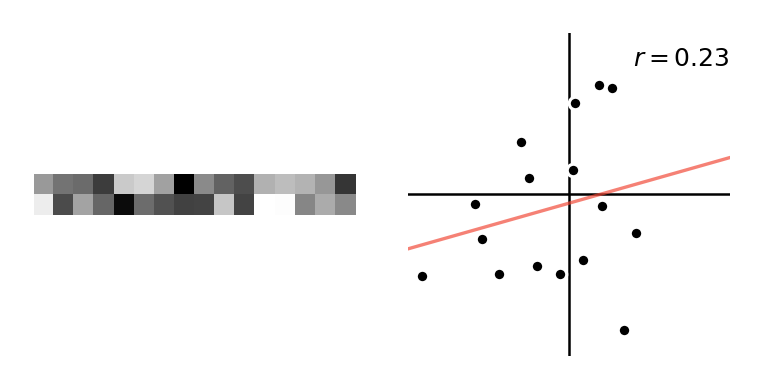

In [223]:
fig, ax = plt.subplots(1, 2, figsize=[colws[1]*0.8, colws[1]*0.8*0.75], dpi=300)
ax = np.ravel(ax)

tickfontsize = 10
labelfontsize = 10
figfontsize = 10

i = 0
ax[i] = sns.heatmap(power_dat[:, :], square=True, cbar=False, cmap='gray', ax=ax[i])
ax[i].set_xticks([])
ax[i].set_yticks([])

i = 1
ax[i].axhline(0, color='k', linewidth=0.6, zorder=0)
ax[i].axvline(0, color='k', linewidth=0.6, zorder=1)
ax[i] = sns.scatterplot(power_dat[0, :], power_dat[1, :], sizes=8, color='k', zorder=3)

fit = stats.linregress(power_dat[0, :], power_dat[1, :])
xmin, xmax = -2, 2
ax[i].plot((xmin, xmax), (fit.intercept + (fit.slope * xmin), fit.intercept + (fit.slope * xmax)),
           color=colors[1], linewidth=0.8, alpha=0.67, zorder=2)
ax[i].annotate('$r = {:.2f}$'.format(fit.rvalue), xy=(0.8, 1.6), fontsize=6)

ax[i].spines['left'].set_visible(False)
ax[i].spines['bottom'].set_visible(False)
ax[i].set_xlim([-2, 2])
ax[i].set_ylim([-2, 2])
ax[i].set_aspect('equal')
ax[i].set_xticks([])
ax[i].set_yticks([])

fig.tight_layout()

if False:
    fig.savefig('/home1/dscho/projects/unit_activity_and_hpc_theta/figs/example_ec_hpc_trace_2sec_U385_ses4_chan1_part2.pdf', 
                format='pdf', bbox_inches='tight')
    fig.savefig('/home1/dscho/projects/unit_activity_and_hpc_theta/figs/example_ec_hpc_trace_2sec_U385_ses4_chan1_part2.png', 
                format='png', dpi=300, bbox_inches='tight')

In [63]:
tickfontsize = 10
labelfontsize = 12

start, duration = 76000, 2000
i = 0
fig, ax = plot_trace(np.vstack((lfp_filt['theta'][:1, :] * 1e6,
                               (lfp_preproc[:1, :] - np.mean(lfp_preproc[:1, :])) * 1e6)), 
                     start=start, duration=duration, x_units='ms', 
                     colors=['k', colors[5]], alphas=[1, 0.15], linewidths=[1, 0.8], 
                     dpi=300, figsize=[4.48819, 4.48819*0.4])

ax[i].set_xticks(np.linspace(start, start+duration, 5))
ax[i].set_xticklabels([0, 0.5, 1.0, 1.5, 2.0], fontsize=tickfontsize)
ax[i].set_xlabel('Time (sec)', fontsize=labelfontsize, labelpad=5)
ax[i].set_ylim([-200, 200])
ax[i].set_yticks(np.linspace(-200, 200, 5))
ax[i].set_yticklabels(np.linspace(-200, 200, 5, dtype=int), fontsize=tickfontsize)
ax[i].set_ylabel('μV', fontsize=labelfontsize, labelpad=2.5)

fig.tight_layout()
if False:
    fig.savefig('/home1/dscho/projects/unit_activity_and_hpc_theta/figs/example_hpc_theta_trace_2sec_U385_ses4_chan1.pdf', 
                format='pdf', bbox_inches='tight')
    fig.savefig('/home1/dscho/projects/unit_activity_and_hpc_theta/figs/example_hpc_theta_trace_2sec_U385_ses4_chan1.png', 
                format='png', dpi=300, bbox_inches='tight')

(56, 2354357)

(<Figure size 3600x1200 with 1 Axes>,
 array([<matplotlib.axes._subplots.AxesSubplot object at 0x2b362a8bba90>],
       dtype=object))

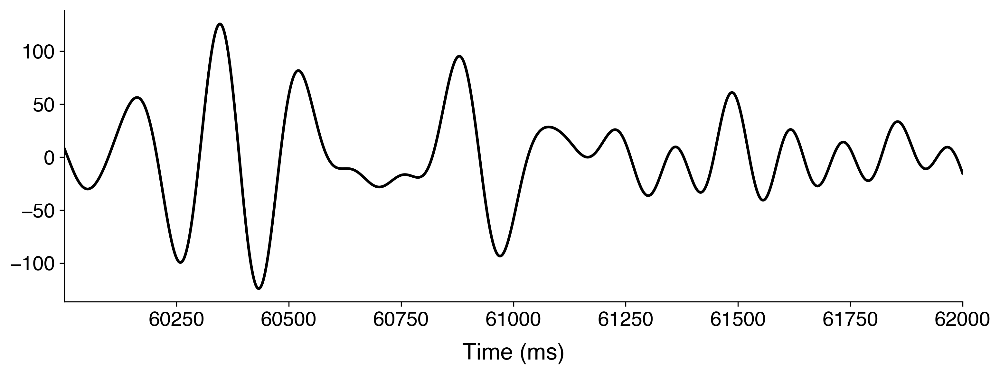

In [23]:
# Piecemeal code...
start_time = time()

# Instantiate LFP bands.
bands = od([('theta', [3, 8])])

subj_sess = 'U385_ses4' #'U387_ses3'
subj_df = phase_locking.get_subj_df()
spikes, fr_df, clus_to_chan, chan_to_clus = phase_locking.load_spikes(subj_sess)
lfp_raw, lfp_preproc = manning_analysis.process_lfp(subj_sess, 
                                                    subj_df=subj_df, 
                                                    notch_freqs=[60, 120, 180],
                                                    interpolate=False,
                                                    session_spikes=spikes)
lfp_filt = phase_locking.filter_lfp_bands(lfp_preproc.sel(channel=['17', '25']), bands, zscore_lfp=False)

print('Done in {:.0f} secs'.format(time() - start_time))

In [13]:
# Piecemeal code...
start_time = time()

# Instantiate LFP bands.
bands = od([('theta', [2, 8])])

subj_sess = 'U384_ses1' #'U394_ses1''U371_env2' #'U369_env1' 'U387_ses3'
subj_df = phase_locking.get_subj_df()
spikes, fr_df, clus_to_chan, chan_to_clus = phase_locking.load_spikes(subj_sess)
lfp_raw, lfp_preproc = manning_analysis.process_lfp(subj_sess, 
                                                    subj_df=subj_df, 
                                                    notch_freqs=[60, 120, 180],
                                                    interpolate=False,
                                                    session_spikes=spikes)

print('Done in {:.0f} secs'.format(time() - start_time))

Done in 62 secs


In [14]:
#fr_df.query("(location=='ROF')")

In [ ]:
ii = 11

start = 1760000 + int(240000*ii) # 2.52e6
duration = 240000
nwin = 60
# dat = lfp_preproc[17:18, :] - np.mean(lfp_preproc[17:18, :])

fig, ax = plt.subplots(nwin, 1, figsize=(colws[2], colws[2]*15), dpi=300)
fig, ax = plot_trace2(dat, 
                      spike_dat=spike_dat, 
                      start=start, 
                      duration=duration, 
                      nwin=nwin,
                      x_units='samples', 
                      colors=['k', '#f37735'], 
                      spike_colors=['#00a0b0'], 
                      same_yaxis=False, 
                      create_spread=False,
                      tickfontsize=6, labelfontsize=8, figfontsize=10, 
                      fig=fig, ax=ax)

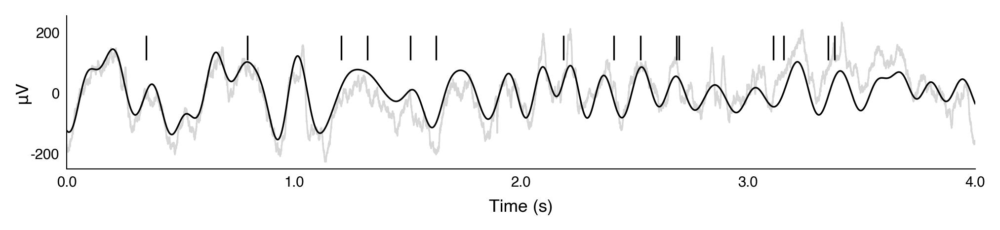

In [18]:
fig, ax = plt.subplots(1, 1, figsize=[colws[2], colws[2]*0.4841*0.5], dpi=300)
ax = np.ravel(ax)

tickfontsize = 7
labelfontsize = 8.5
colors_ = ['k', 'k'] #['#f37735', '#00a0b0']

iChans = [8, 16]
offset = 100
alphas_ = [0.3, 1] #[0.3, 1]
line_colors_ = [colors[5], 'k']

# start, duration = 197200, 2000 # 390000
start, duration = 2522150-3750, 8000
# start, duration = 390000 + 7000, 6000
# dat = np.vstack((lfp_preproc[iChans[0]:iChans[0]+1, start:start+duration] - np.mean(lfp_preproc[iChans[0]:iChans[0]+1, start:start+duration]),
#                  lfp_preproc[iChans[1]:iChans[1]+1, start:start+duration] - np.mean(lfp_preproc[iChans[1]:iChans[1]+1, start:start+duration])))

# lfp_filt = phase_locking.filter_lfp_bands(lfp_preproc.sel(channel=[str(iChans[0]+1)]), bands, zscore_lfp=False)
# dat = np.vstack((lfp_preproc[iChans[0]:iChans[0]+1, start:start+duration] - np.mean(lfp_preproc[iChans[0]:iChans[0]+1, start:start+duration]),
#                  lfp_preproc[iChans[1]:iChans[1]+1, start:start+duration] - np.mean(lfp_preproc[iChans[1]:iChans[1]+1, start:start+duration])))
#                  lfp_filt['epsilon'][:, start:start+duration]))
# dat *= 1e6
# dat[0, :] = dat[0, :] + offset

bands = od([('theta', [2, 8])])
lfp_filt = phase_locking.filter_lfp_bands(lfp_preproc.sel(channel=[str(iChans[1]+1)]), bands, zscore_lfp=False)
dat = np.vstack((lfp_preproc[iChans[1]:iChans[1]+1, start:start+duration] - np.mean(lfp_preproc[iChans[1]:iChans[1]+1, start:start+duration]),
                 lfp_filt['theta'][:, start:start+duration]))
# dat = lfp_preproc[iChans[1]:iChans[1]+1, start:start+duration] - np.mean(lfp_preproc[iChans[1]:iChans[1]+1, start:start+duration])
# dat = np.vstack((lfp_preproc[iChans[1]:iChans[1]+1, start:start+duration] - np.mean(lfp_preproc[iChans[1]:iChans[1]+1, start:start+duration])))
dat *= 1e6

i = 0
for iLine in range(dat.shape[0]):
    ax[i].plot(dat[iLine, :], color=line_colors_[iLine], alpha=alphas_[iLine], linewidth=0.8)
    if iLine == 0:
        for iUnit in range(1, 2):
            spike_inds = np.where(fr_df.query("(chan=='{}')".format(iChans[0]+1)).iloc[iUnit]['spikes'])[0]
            spike_vec = np.zeros(duration)
            spike_vec[spike_vec==0] = np.nan
            spike_vec[spike_inds[(spike_inds>=start) & (spike_inds<start+duration)] - start] = 1.5 * offset
            ax[i].plot(spike_vec, marker='|', markerfacecolor=colors_[iUnit], markeredgecolor=colors_[iUnit], 
                       linewidth=0, alpha=1, markeredgewidth=0.8, markersize=12)
    ax[i].set_xlim([0, duration])
    ax[i].set_xticks(np.linspace(0, duration, 5))
    ax[i].set_xticklabels(np.linspace(0, duration/2000, 5), fontsize=tickfontsize)
    ax[i].set_xlabel('Time (s)', fontsize=labelfontsize, labelpad=5)
#     ax[i].set_ylim([-200, 400])
    ax[i].set_yticks(np.linspace(-200, 200, 3))
    ax[i].set_yticklabels(np.linspace(-200, 200, 3, dtype=int), fontsize=tickfontsize)
    ax[i].set_ylabel('μV', fontsize=labelfontsize, labelpad=0)
    for axis in ['top','bottom','left','right']:
        ax[i].spines[axis].set_linewidth(0.5)
    ax[i].tick_params(width=0.5, length=0)
#     ax[i].axes.get_yaxis().set_visible(False)
#     ax[i].spines['left'].set_visible(False)

fig.tight_layout()

if False:
    fig.savefig('/home1/dscho/projects/unit_activity_and_hpc_theta/figs/example_phase-locking_trace_4sec_U384_ses1_chan1.pdf', 
                format='pdf', bbox_inches='tight')
    fig.savefig('/home1/dscho/projects/unit_activity_and_hpc_theta/figs/example_phase-locking_trace_4sec_U384_ses1_chan1.png', 
                format='png', dpi=300, bbox_inches='tight')

In [699]:
iChans = [39, 8] #[24, 43]#[8, 16]
iUnit = 0

bands = od([('theta', [1, 8])])
lfp_filt = phase_locking.filter_lfp_bands(lfp_preproc.sel(channel=[str(iChans[1]+1)]), bands, zscore_lfp=False)
dat = np.vstack((lfp_preproc[iChans[1]:iChans[1]+1, :] - np.mean(lfp_preproc[iChans[1]:iChans[1]+1, :]),
                 lfp_filt['theta']))

spike_inds = np.where(fr_df.query("(chan=='{}')".format(iChans[0]+1)).iloc[iUnit]['spikes'])[0]
spike_vec = np.zeros(lfp_preproc.shape[1])
spike_vec[spike_inds] = 1
spike_dat = np.expand_dims(spike_vec, axis=0)

In [700]:
ii = 1 #8 4 3 2 1

start = 0 + int(240000*ii) # 2.52e6
duration = 240000
nwin = 60
# dat = lfp_preproc[17:18, :] - np.mean(lfp_preproc[17:18, :])

fig, ax = plt.subplots(nwin, 1, figsize=(colws[2], colws[2]*15), dpi=300)
fig, ax = plot_trace2(dat, 
                      spike_dat=spike_dat, 
                      start=start, 
                      duration=duration, 
                      nwin=nwin,
                      x_units='samples', 
                      colors=['k', '#f37735'], 
                      spike_colors=['#00a0b0'], 
                      same_yaxis=False, 
                      create_spread=False,
                      tickfontsize=6, labelfontsize=8, figfontsize=10, 
                      fig=fig, ax=ax)

(<Figure size 3600x1200 with 1 Axes>,
 array([<matplotlib.axes._subplots.AxesSubplot object at 0x2b67d2ef7240>],
       dtype=object))

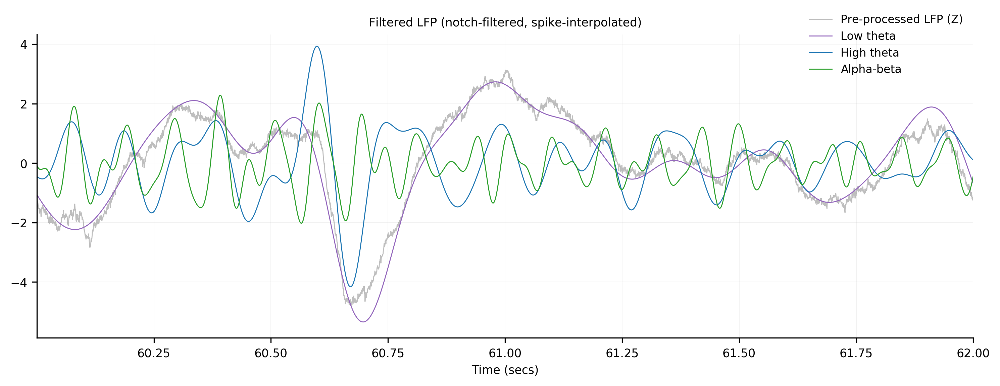

In [142]:
i = 20
plot_trace(np.vstack((((lfp_preproc.data[i, :] - np.mean(lfp_preproc.data[i, :])) / np.std(lfp_preproc.data[i, :])), 
                      lfp_filt['low_theta'][i, :], 
                      lfp_filt['high_theta'][i, :], 
                      lfp_filt['alpha_beta'][i, :])),
           start=60, duration=2, x_units='secs', 
           colors=['C7', 'C4', 'C0', 'C2'], alphas=[0.5, 1, 1, 1],
           legend_labels=['Pre-processed LFP (Z)', 'Low theta', 'High theta', 'Alpha-beta'], 
           dpi=300, title='Filtered LFP (notch-filtered, spike-interpolated)')

(<Figure size 3600x1200 with 1 Axes>,
 array([<matplotlib.axes._subplots.AxesSubplot object at 0x2b67d2f26710>],
       dtype=object))

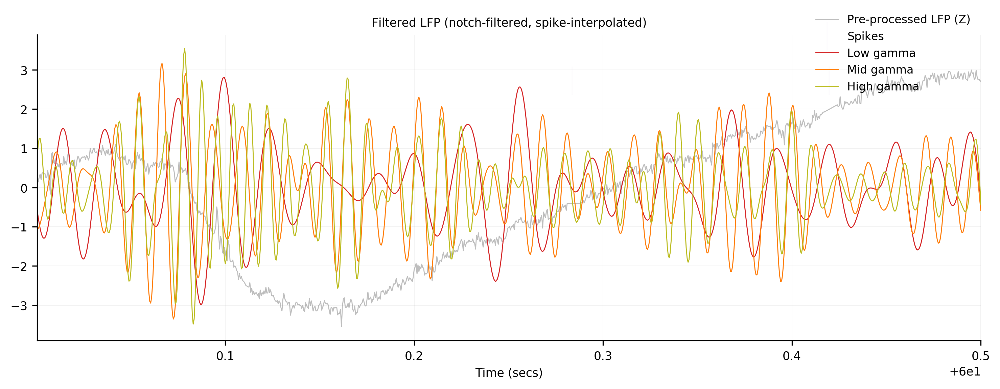

In [147]:
i = 8
spike_train = fr_df.query("(chan=='{}')".format(i+1)).spikes.iat[0]
plot_trace(np.vstack((((lfp_preproc.data[i, :] - np.mean(lfp_preproc.data[i, :])) / np.std(lfp_preproc.data[i, :])), 
                      spike_train, 
                      lfp_filt['low_gamma'][i, :], 
                      lfp_filt['mid_gamma'][i, :], 
                      lfp_filt['high_gamma'][i, :])),
           start=60, duration=0.5, x_units='secs', markers=[None, '|', None, None, None],
           colors=['C7', 'C4', 'C1', 'C3', 'C8'], alphas=[0.5, 1, 1, 1, 1],
           legend_labels=['Pre-processed LFP (Z)', 'Spikes', 'Low gamma', 'Mid gamma', 'High gamma'], 
           dpi=300, title='Filtered LFP (notch-filtered, spike-interpolated)')

(<Figure size 3600x1200 with 1 Axes>,
 array([<matplotlib.axes._subplots.AxesSubplot object at 0x2b52f700a128>],
       dtype=object))

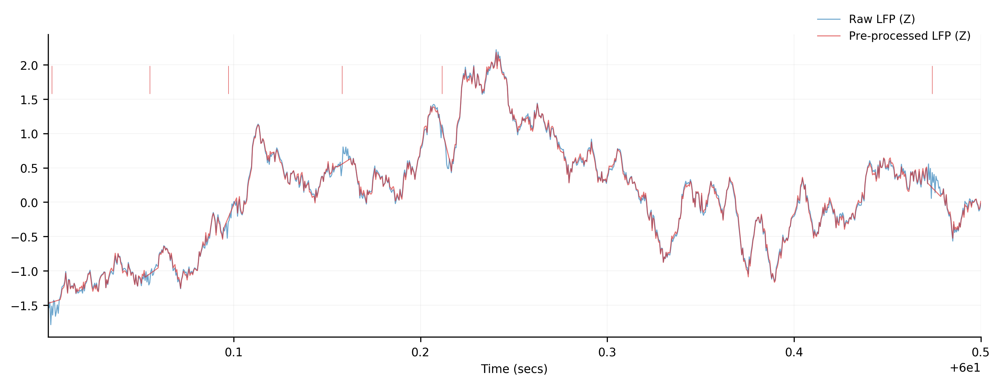

In [69]:
plot_trace(np.vstack((lfp_raw.data[i, :], lfp_preproc.data[i, :], spike_train)),
           start=60, duration=0.5, x_units='secs', 
           colors=['C0', 'C1', 'C1'], alphas=[0.66, 0.66, 1], markers=[None, None, '|'],
           legend_labels=['Raw LFP (Z)', 'Pre-processed LFP (Z)'], dpi=300)

Text(0.5,1,'Spike-triggered average')

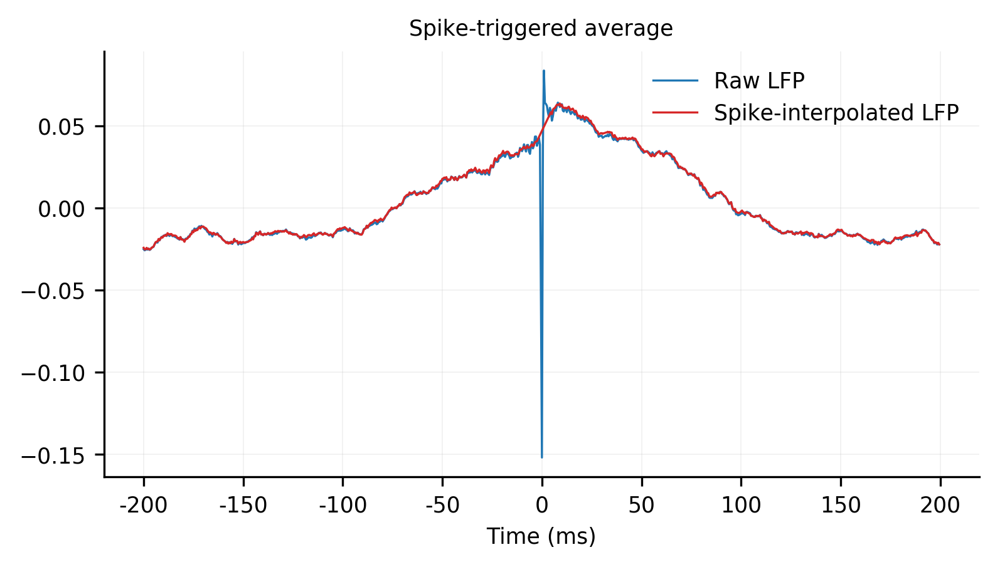

In [74]:
sta = []
sta2 = []
for ind in np.where(spike_train)[0][1:-1]:
    sta.append(lfp_raw.data[i, ind-400:ind+400])
    sta2.append(lfp_preproc.data[i, ind-400:ind+400])
sta = np.array(sta)
sta2 = np.array(sta2)

plt.figure(figsize=(6, 3), dpi=300)
plt.plot(np.mean(sta, axis=0), label='Raw LFP')
plt.plot(np.mean(sta2, axis=0), label='Spike-interpolated LFP')
plt.legend()
plt.xticks(np.linspace(0, 800, 9), [int(x) for x in np.linspace(-200, 200, 9)])
plt.xlabel('Time (ms)')
plt.title('Spike-triggered average')

(<Figure size 3600x1200 with 1 Axes>,
 array([<matplotlib.axes._subplots.AxesSubplot object at 0x2b67c64140f0>],
       dtype=object))

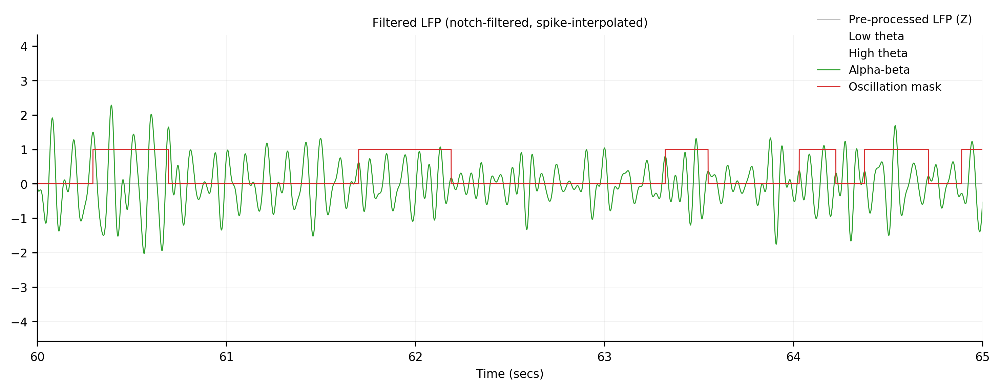

In [154]:
i = 20
cat = 'alpha_beta'
#vec = cycles_to_lfp(cycle_stats, channel=i, category='power_rank', cycle_type=cat) / len(cycle_stats[cat]['power'][i])
vec = cycles_to_lfp(cycle_stats, channel=i, category='osc_mask', cycle_type=cat)
plot_trace(np.vstack((lfp_preproc.data[i, :], lfp_filt[cat][i, :], 
                      lfp_filt['high_theta'][i, :], lfp_filt['alpha_beta'][i, :], vec)),
           start=60, duration=5, x_units='secs', 
           colors=['C7', 'C4', 'C0', 'C2', 'C1'], alphas=[0.5, 0, 0, 1, 1],
           legend_labels=['Pre-processed LFP (Z)', 'Low theta', 'High theta', 'Alpha-beta', 'Oscillation mask'], 
           dpi=300, title='Filtered LFP (notch-filtered, spike-interpolated)')

(<Figure size 3600x1200 with 1 Axes>,
 array([<matplotlib.axes._subplots.AxesSubplot object at 0x2b53225dd2e8>],
       dtype=object))

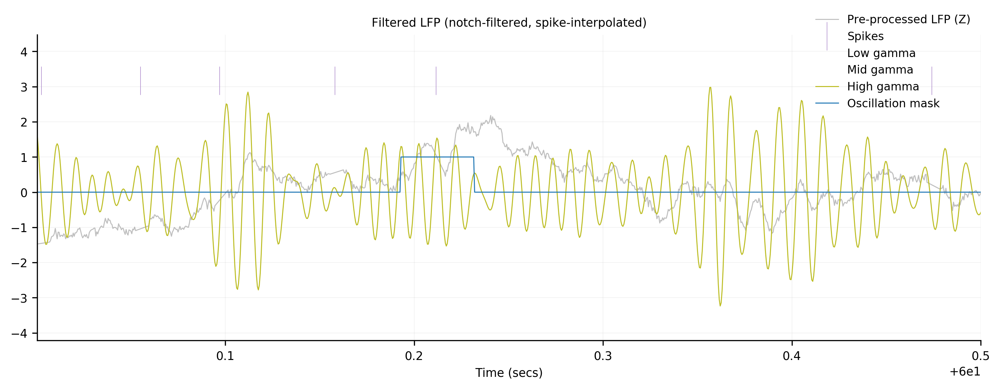

In [121]:
i = 20
cat = 'high_gamma'
vec = cycles_to_lfp(cycle_stats, channel=i, category='osc_mask', cycle_type=cat)
spike_train = fr_df.query("(chan=='{}')".format(i+1)).spikes.iat[0]
plot_trace(np.vstack((lfp_preproc.data[i, :], spike_train, lfp_filt['low_gamma'][i, :], 
                      lfp_filt['mid_gamma'][i, :], lfp_filt['high_gamma'][i, :], vec)),
           start=60, duration=0.5, x_units='secs', markers=[None, '|', None, None, None, None],
           colors=['C7', 'C4', 'C1', 'C3', 'C8', 'C0'], alphas=[0.5, 1, 0, 0, 1, 1],
           legend_labels=['Pre-processed LFP (Z)', 'Spikes', 'Low gamma', 'Mid gamma', 'High gamma', 'Oscillation mask'], 
           dpi=300, title='Filtered LFP (notch-filtered, spike-interpolated)')

(<Figure size 3600x1200 with 1 Axes>,
 array([<matplotlib.axes._subplots.AxesSubplot object at 0x2b67c63ec828>],
       dtype=object))

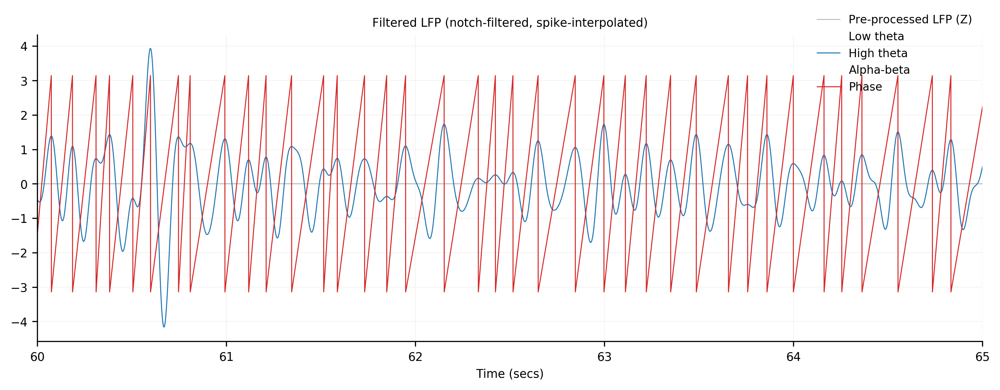

In [155]:
i = 20
cat = 'high_theta'
#vec = cycles_to_lfp(cycle_stats, channel=i, category='power_rank', cycle_type=cat) / len(cycle_stats[cat]['power'][i])
vec = phase[cat]['phase'][i, :]
plot_trace(np.vstack((lfp_preproc.data[i, :], lfp_filt[cat][i, :], 
                      lfp_filt['high_theta'][i, :], lfp_filt['alpha_beta'][i, :], vec)),
           start=60, duration=5, x_units='secs', 
           colors=['C7', 'C4', 'C0', 'C2', 'C1'], alphas=[0.5, 0, 1, 0, 1],
           legend_labels=['Pre-processed LFP (Z)', 'Low theta', 'High theta', 'Alpha-beta', 'Phase'], 
           dpi=300, title='Filtered LFP (notch-filtered, spike-interpolated)')

In [63]:
print('Circular correlations between phase for raw vs. notch-filtered LFP'.format(band_name))
for band_name in bands.keys():
    mean_phase_corr = np.array([circstats.circcorrcoef(phase_nonotch[band_name]['phase'][i], 
                                                       phase_notch[band_name]['phase'][i]) 
                                for i in range(64)]).mean()
    print('{}: {}'.format(band_name, round(mean_phase_corr, 4)))

Circular correlations between phase for raw vs. notch-filtered LFP
low_theta: 0.9945
high_theta: 0.9944
alpha_beta: 0.9931
low_gamma: 0.8626
mid_gamma: 0.618
high_gamma: 0.8654


## Characterize phase-locking to each band.

In [7]:
# Get a list of sessions that need to be processed.
pl_df_files = glob.glob('/scratch/dscho/phase_precession/data/phase_locking/*_phase_locking_df_duration_mask_peaks_25powpct_3osclength.pkl')
processed_sessions = [os.path.basename(f)[:9] for f in pl_df_files if os.path.basename(f)[:9]]
sessions_to_process = [subj for subj in sessions if subj not in processed_sessions]
sessions_to_process

[]

In [ ]:
# Calculate phase-locking stats for each unit in a session.
for subj_sess in sessions:
    start_time = time()
    pl_df = phase_locking.calc_phase_locking_bands(subj_sess, bands=bands, mask_type=None)
    pl_df = phase_locking.calc_phase_locking_bands(subj_sess, bands=bands, mask_type='duration_mask')
    print('Done in {:.0f} secs'.format(time() - start_time))

Saved /scratch/dscho/phase_precession/data/phase_locking/U369_env1_phase_locking_df_no_mask_peaks_25powpct_3osclength.pkl
Saved /scratch/dscho/phase_precession/data/phase_locking/U369_env1_phase_locking_df_duration_mask_peaks_25powpct_3osclength.pkl
Done in 320 secs
Saved /scratch/dscho/phase_precession/data/phase_locking/U369_env2_phase_locking_df_no_mask_peaks_25powpct_3osclength.pkl
Saved /scratch/dscho/phase_precession/data/phase_locking/U369_env2_phase_locking_df_duration_mask_peaks_25powpct_3osclength.pkl
Done in 191 secs


In [8]:
# Load phase-locking DataFrames.
pl_df = phase_locking.open_pickle(pl_df_files[0])
for f in pl_df_files[1:]:
    pl_df = pl_df.append(phase_locking.open_pickle(f))
pl_df.reset_index(drop=True, inplace=True)

In [9]:
# Upload local phase-locking results
alpha = 0.05
bonf_alpha = max(0.001, 0.05 / len(bands))
#bonf_alpha = 0.001
print('Alpha: {}; Bonferroni-corrected alpha: {}'.format(alpha, round(bonf_alpha, 4)))
band_names = np.array(list(bands.keys()))

pl_df['sig'] = pl_df.pvals.apply(lambda x: np.any(x < bonf_alpha))
pl_df['sigs'] = pl_df.pvals.apply(lambda x: x < bonf_alpha)
pl_df['pval_argmin'] = pl_df.pvals.apply(lambda x: np.argmin(x))
pl_df['length_argmax'] = pl_df.lengths.apply(lambda x: np.argmax(x))

sig_type_single = 'pval_argmin'
sig_type_multi = 'sigs'

locked_bands = []
locked_phases = []
locked_lengths = []
locked_pvals = []
for i in range(len(pl_df)):
    ind = pl_df.at[i, sig_type_single]
    locked_bands.append(band_names[ind])
    locked_phases.append(pl_df.at[i, 'means'][ind])
    locked_lengths.append(pl_df.at[i, 'lengths'][ind])
    locked_pvals.append(pl_df.at[i, 'pvals'][ind])
pl_df['locked_band'] = np.array(locked_bands)
pl_df['locked_phase'] = np.array(locked_phases)
pl_df['locked_length'] = np.array(locked_lengths)
pl_df['locked_pval'] = np.array(locked_pvals)

locked_bands = []
locked_phases = []
locked_lengths = []
locked_pvals = []
for i in range(len(pl_df)):
    inds = pl_df.at[i, sig_type_multi]
    locked_bands.append(band_names[inds])
    locked_phases.append(pl_df.at[i, 'means'][inds])
    locked_lengths.append(pl_df.at[i, 'lengths'][inds])
    locked_pvals.append(pl_df.at[i, 'pvals'][inds])
pl_df['locked_bands'] = np.array(locked_bands)
pl_df['locked_phases'] = np.array(locked_phases)
pl_df['locked_lengths'] = np.array(locked_lengths)
pl_df['locked_pvals'] = np.array(locked_pvals)
pl_df['n_locked'] = pl_df.locked_pvals.apply(lambda x: len(x))

pl_df_sig = pl_df.query("(sig==True)")

Alpha: 0.05; Bonferroni-corrected alpha: 0.0083


In [10]:
stats.pearsonr(list(pl_df_sig.pval_argmin), list(pl_df_sig.length_argmax))

(0.7844540928690137, 1.6838623910513485e-113)

In [11]:
# What percent of units are phase-locked to any frequency?
print(len(pl_df.query("(sig==True)")) / len(pl_df))

0.8408736349453978


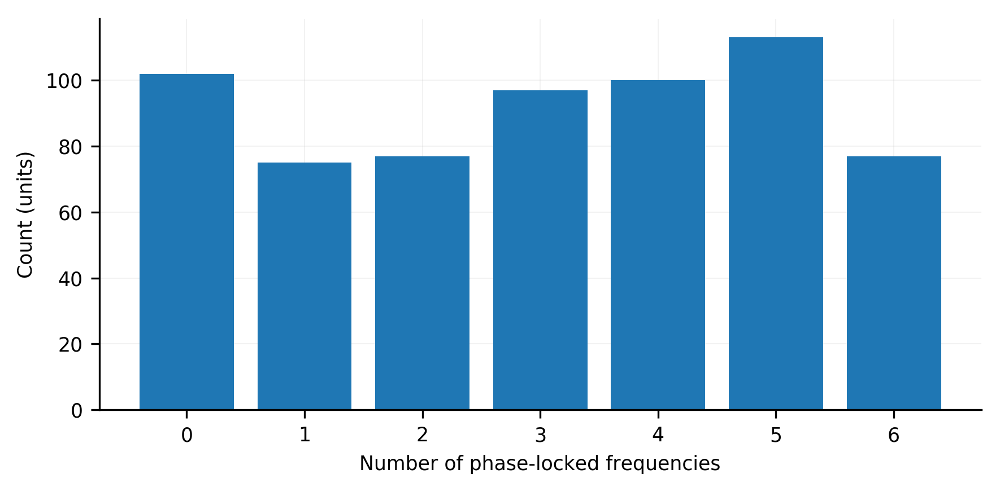

In [31]:
# How many frequencies is each unit phase-locked to? 
fig, ax = plt.subplots(1, 1, figsize=(6, 3), dpi=300)
ax = np.ravel(ax)

ax[0].bar(pl_df.groupby('n_locked').sig.count().index.tolist(), pl_df.groupby('n_locked').sig.count().tolist())
ax[0].set_xlabel('Number of phase-locked frequencies')
ax[0].set_ylabel('Count (units)')
fig.tight_layout()

In [13]:
# How many of each neuron type do we have (sig, total)?
print('Hippocampus: ', len(pl_df.query("(is_hpc==True) & (sig==True)")),
      len(pl_df.query("(is_hpc==True)")))
print('Parahippocampal: ', len(pl_df.query("(is_hpc==False) & (roi==['EC', 'PG']) & (sig==True)")), 
      len(pl_df.query("(is_hpc==False) & (roi==['EC', 'PG'])")))
print('Amygdala: ', len(pl_df.query("(is_hpc==False) & (roi==['A']) & (sig==True)")),
      len(pl_df.query("(is_hpc==False) & (roi==['A'])")))
print('Frontal: ', len(pl_df.query("(is_hpc==False) & (roi==['OF', 'AC', 'SMA', 'pSMA']) & (sig==True)")),
      len(pl_df.query("(is_hpc==False) & (roi==['OF', 'AC', 'SMA', 'pSMA'])")))
print('Cortex (Other): ', len(pl_df.query("(is_hpc==False) & (roi!=['A', 'EC', 'PG', 'OF', 'AC', 'SMA', 'pSMA']) & (sig==True)")),
      len(pl_df.query("(is_hpc==False) & (roi!=['A', 'EC', 'PG', 'OF', 'AC', 'SMA', 'pSMA'])")))

Hippocampus:  110 138
Parahippocampal:  147 163
Amygdala:  123 149
Frontal:  54 69
Cortex (Other):  105 122


In [190]:
df = OrderedDict()
total = 0
rois = ['hpc', 'phpc', 'amg', 'fl', 'ctx']
fancy_names = {'hpc': 'Hippocampus', 
               'phpc': 'Parahippocampus', 
               'amg': 'Amygdala', 
               'fl': 'Frontal', 
               'ctx': 'Cortex (Other)'}
sig_type = 'sig'
df['hpc'] = pl_df_sig.query("(is_hpc==True)")
df['phpc'] = pl_df_sig.query("(roi==['EC', 'PG'])")
df['amg'] = pl_df_sig.query("(roi=='A')")
df['fl'] = pl_df_sig.query("(roi==['OF', 'AC', 'SMA', 'pSMA'])")
df['ctx'] = pl_df_sig.query("(is_hpc==False) & (roi!=['A', 'EC', 'PG', 'OF', 'AC', 'SMA', 'pSMA'])")
for roi in df.keys():
    print('{}: {} units'.format(fancy_names[roi], len(df[roi])))
    total += len(df[roi])
print('{} phase-locked units'.format(total))

counts = OrderedDict()
for roi in df.keys():
    counts[roi] = OrderedDict()
    d = df[roi].groupby('locked_band').unit.count().to_dict()
    for band_name in band_names:
        if band_name not in d:
            counts[roi][band_name] = 0
        else:
            counts[roi][band_name] = d[band_name]

Hippocampus: 110 units
Parahippocampus: 147 units
Amygdala: 123 units
Frontal: 54 units
Cortex (Other): 105 units
539 phase-locked units


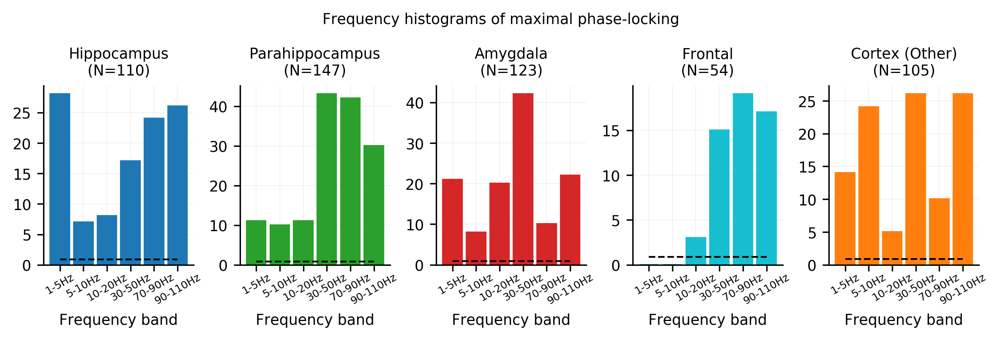

In [191]:
colors = ['C0', 'C2', 'C1', 'C9', 'C3']
labels = ['1-5Hz', '5-10Hz', '10-20Hz', '30-50Hz', '70-90Hz', '90-110Hz']

fig, ax = plt.subplots(1, 5, figsize=(8, 2.5), dpi=300)
ax = np.ravel(ax)
exp_fp = bonf_alpha * len(df[roi]) # the expected number of false positive electrodes in each band

for i, roi in enumerate(rois):
    ax[i].bar(np.arange(len(band_names)), np.array(list(counts[roi].values())), 
              color=colors[i], edgecolor=colors[i])
    ax[i].plot(np.arange(len(band_names)), [exp_fp] * len(band_names), color='k', linestyle='--', linewidth=1)
    ax[i].set_xticks(np.arange(0, len(band_names)))
    ax[i].set_xticklabels(labels, rotation=30, fontsize=6, y=0.03) 
    ax[i].set_xlabel('Frequency band')
    ax[i].set_title('{}\n(N={})'.format(fancy_names[roi], np.sum(list(counts[roi].values()))))

fig.suptitle('Frequency histograms of maximal phase-locking', y=1.05)
fig.tight_layout(w_pad=-0.5, h_pad=0)

In [16]:
pl_df_sig.columns

Index(['subj_sess', 'unit', 'chan', 'hem', 'roi', 'hemroi', 'is_hpc',
       'spike_inds', 'phases', 'means', 'lengths', 'pvals', 'sig', 'sigs',
       'pval_argmin', 'length_argmax', 'locked_band', 'locked_phase',
       'locked_length', 'locked_pval', 'locked_bands', 'locked_phases',
       'locked_lengths', 'locked_pvals', 'n_locked'],
      dtype='object')

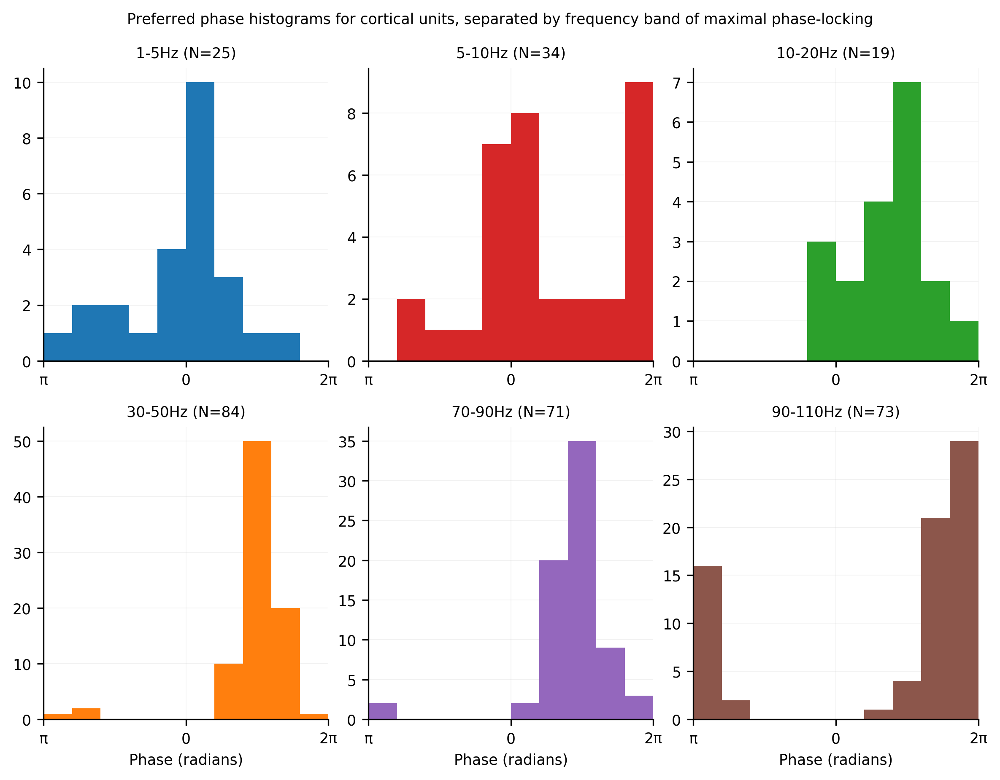

In [20]:
mus = []
for band_name in band_names:
    #mus.append(convert_radians(np.array(pl_df_sig.query("(locked_band=='{}') & (is_hpc==True)".format(band_name)).locked_phase.tolist())))
    mus.append(np.array(pl_df_sig.query("(locked_band=='{}') & (is_hpc==False) & (roi!='A')".format(band_name)).locked_phase.tolist()))

labels = ['1-5Hz', '5-10Hz', '10-20Hz', '30-50Hz', '70-90Hz', '90-110Hz']

fig, ax = plt.subplots(2, 3, sharex=False, figsize=(8, 6), dpi=300)
ax = np.ravel(ax)

for i in range(6):
    ax[i].hist(mus[i], bins=np.linspace(-np.pi, np.pi, 11), color='C{}'.format(i))
    ax[i].set_xlim([-np.pi, np.pi])
    ax[i].set_xticks([0, -np.pi, np.pi])
    ax[i].set_xticklabels([0, 'π', '2π'])
    if i > 2:
        ax[i].set_xlabel('Phase (radians)')
    ax[i].set_title('{} (N={})'.format(labels[i], len(mus[i])))
    
fig.suptitle('Preferred phase histograms for cortical units, separated by frequency band of maximal phase-locking', y=1.02)
fig.tight_layout(w_pad=0, h_pad=1)

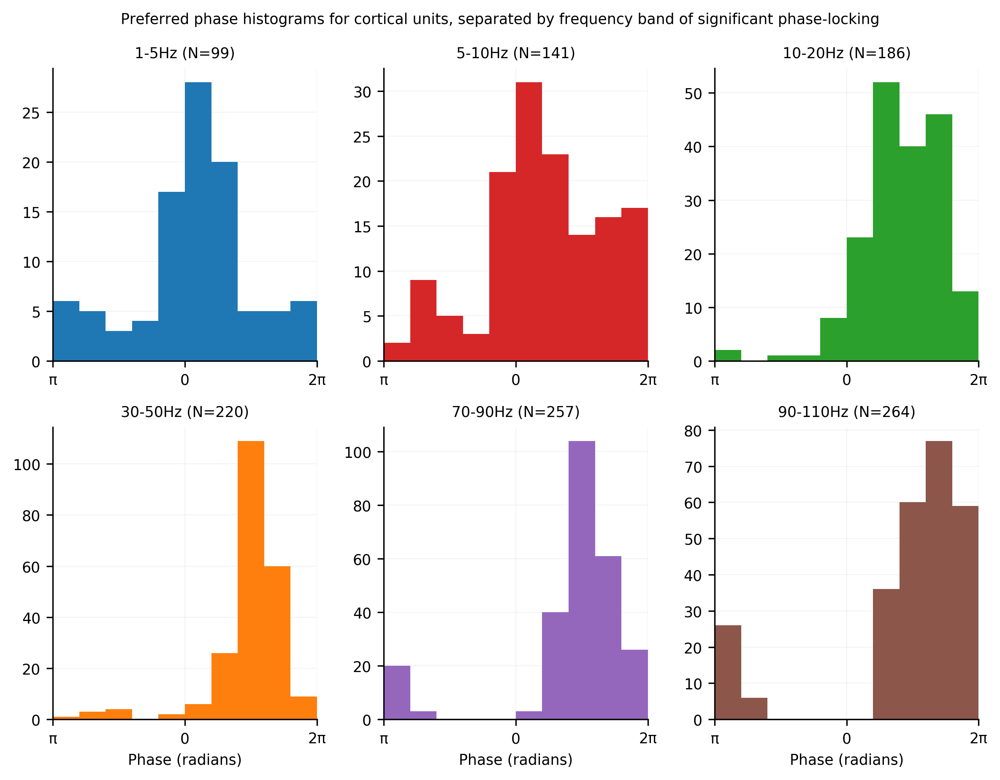

In [26]:
mus = []
for i, band_name in enumerate(band_names):
    #mus.append(convert_radians(np.array(pl_df_sig.query("(locked_band=='{}') & (is_hpc==True)".format(band_name)).locked_phase.tolist())))
    mus.append(np.array(pl_df[pl_df.locked_bands.apply(lambda x: band_name in x)].query("(is_hpc==False) & (roi!='A')").means.apply(lambda x: x[i]).tolist()))

labels = ['1-5Hz', '5-10Hz', '10-20Hz', '30-50Hz', '70-90Hz', '90-110Hz']

fig, ax = plt.subplots(2, 3, sharex=False, sharey=False, figsize=(8, 6), dpi=300)
ax = np.ravel(ax)

for i in range(6):
    ax[i].hist(mus[i], bins=np.linspace(-np.pi, np.pi, 11), color='C{}'.format(i))
    ax[i].set_xlim([-np.pi, np.pi])
    ax[i].set_xticks([0, -np.pi, np.pi])
    ax[i].set_xticklabels([0, 'π', '2π'])
    if i > 2:
        ax[i].set_xlabel('Phase (radians)')
    ax[i].set_title('{} (N={})'.format(labels[i], len(mus[i])))
    
fig.suptitle('Preferred phase histograms for cortical units, separated by frequency band of significant phase-locking', y=1.02)
fig.tight_layout(w_pad=1, h_pad=1)

Median length of phase-locked unit: 0.11251741824937249


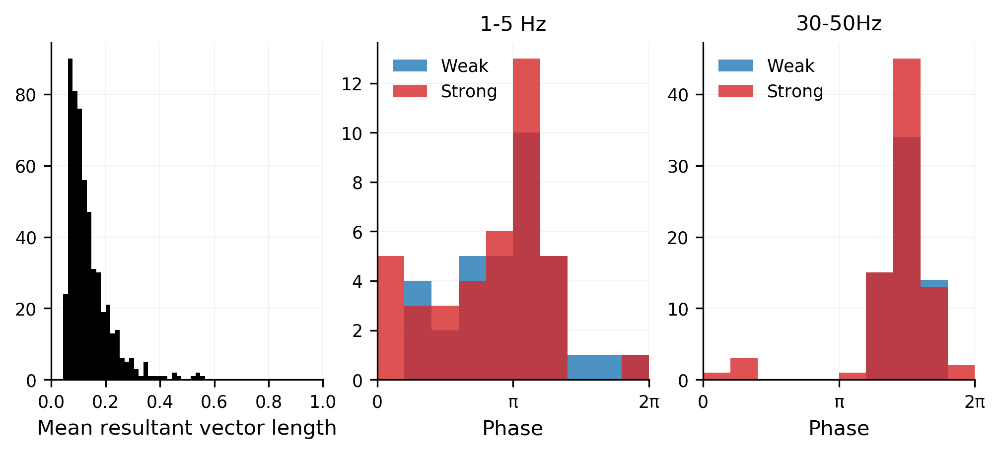

In [206]:
lengths = np.array(pl_df_sig.locked_length.tolist())
length_thresh = np.percentile(lengths, 50)
print('Median length of phase-locked unit: {}'.format(length_thresh))
mus_theta_low = np.array(pl_df_sig.query("(locked_band=='low_theta') & (locked_length<={})".format(length_thresh)).locked_phase.tolist())
mus_theta_high = np.array(pl_df_sig.query("(locked_band=='low_theta') & (locked_length>{})".format(length_thresh)).locked_phase.tolist())
mus_gamma_low = np.array(pl_df_sig.query("(locked_band=='low_gamma') & (locked_length<={})".format(length_thresh)).locked_phase.tolist())
mus_gamma_high = np.array(pl_df_sig.query("(locked_band=='low_gamma') & (locked_length>{})".format(length_thresh)).locked_phase.tolist())
# mus_theta_low = convert_radians(mus_theta_low)
# mus_theta_high = convert_radians(mus_theta_high)
# mus_gamma_low = convert_radians(mus_gamma_low)
# mus_gamma_high = convert_radians(mus_gamma_high)

fig, ax = plt.subplots(1, 3, figsize=(8, 3), dpi=300)
ax = np.ravel(ax)

ax[0].hist(lengths, bins=30, color='k')
ax[0].set_xlim([0, 1])
ax[0].set_xlabel('Mean resultant vector length', fontsize=10)

ax[1].hist(mus_theta_low, bins=np.linspace(-np.pi, np.pi, 11), color='C0', alpha=0.8, label='Weak')
ax[1].hist(mus_theta_high, bins=np.linspace(-np.pi, np.pi, 11), color='C1', alpha=0.8, label='Strong')
ax[1].set_xlim([-np.pi, np.pi])
ax[1].set_xticks([-np.pi, 0, np.pi])
ax[1].set_xticklabels([0, 'π', '2π'])
ax[1].set_xlabel('Phase', fontsize=10)
ax[1].set_title('1-5 Hz', fontsize=10)
ax[1].legend()

ax[2].hist(mus_gamma_low, bins=np.linspace(-np.pi, np.pi, 11), color='C0', alpha=0.8, label='Weak')
ax[2].hist(mus_gamma_high, bins=np.linspace(-np.pi, np.pi, 11), color='C1', alpha=0.8, label='Strong')
ax[2].set_xlim([-np.pi, np.pi])
ax[2].set_xticks([-np.pi, 0, np.pi])
ax[2].set_xticklabels([0, 'π', '2π'])
ax[2].set_xlabel('Phase', fontsize=10)
ax[2].set_title('30-50Hz', fontsize=10)
ax[2].legend()

In [207]:
# Here we will look at the depth of modulation (circmom) at
# each frequency among neurons phase-locked to any frequency
# i.e. circmoms are included at non-phase-locked frequencies as
# long as a unit is phase-locked to something.

rois = ['hpc', 'phpc', 'amg', 'fl', 'ctx']
fancy_names = {'hpc': 'Hippocampus', 
               'phpc': 'Parahippocampus', 
               'amg': 'Amygdala', 
               'fl': 'Frontal', 
               'ctx': 'Cortex (Other)'}

# All phase-locked units
df = OrderedDict()
total = 0
df['hpc'] = pl_df_sig.query("(is_hpc==True)")
df['phpc'] = pl_df_sig.query("(roi==['EC', 'PG'])")
df['amg'] = pl_df_sig.query("(roi=='A')")
df['fl'] = pl_df_sig.query("(roi==['OF', 'AC', 'SMA', 'pSMA'])")
df['ctx'] = pl_df_sig.query("(is_hpc==False) & (roi!=['A', 'EC', 'PG', 'OF', 'AC', 'SMA', 'pSMA'])")
print('All phase-locked units')
for roi in df.keys():
    print('{}: {} units'.format(fancy_names[roi], len(df[roi])))
    total += len(df[roi])
print('{} phase-locked units\n'.format(total))

counts2 = OrderedDict()
counts2['all'] = OrderedDict()
for roi in df.keys():
    lengths = df[roi].lengths.tolist()
    od = OrderedDict()
    for iunit in range(len(lengths)):
        for iband in range(len(band_names)):
            od.setdefault(band_names[iband], []).append(lengths[iunit][iband])
    counts2['all'][roi] = OrderedDict(zip(np.array(list(od.keys())), np.array([np.mean(x) for x in list(od.values())])))

# Units maximally phase-locked to each band.
df = OrderedDict()
for band_name in band_names:
    total = 0
    df['hpc'] = pl_df_sig.query("(is_hpc==True) & (locked_band=='{}')".format(band_name))
    df['phpc'] = pl_df_sig.query("(roi==['EC', 'PG']) & (locked_band=='{}')".format(band_name))
    df['amg'] = pl_df_sig.query("(roi=='A') & (locked_band=='{}')".format(band_name))
    df['fl'] = pl_df_sig.query("(roi==['OF', 'AC', 'SMA', 'pSMA']) & (locked_band=='{}')".format(band_name))
    df['ctx'] = pl_df_sig.query("(is_hpc==False) & (roi!=['A', 'EC', 'PG', 'OF', 'AC', 'SMA', 'pSMA']) & (locked_band=='{}')".format(band_name))
    print('Units maximally phase-locked to {}'.format(band_name))
    for roi in df.keys():
        print('{}: {} units'.format(fancy_names[roi], len(df[roi])))
        total += len(df[roi])
    print('{} phase-locked units\n'.format(total))
    
    counts2[band_name] = OrderedDict()
    for roi in df.keys():
        lengths = df[roi].lengths.tolist()
        od = OrderedDict()
        for iunit in range(len(lengths)):
            for iband in range(len(band_names)):
                od.setdefault(band_names[iband], []).append(lengths[iunit][iband])
        counts2[band_name][roi] = OrderedDict(zip(np.array(list(od.keys())), np.array([np.mean(x) for x in list(od.values())])))

All phase-locked units
Hippocampus: 110 units
Parahippocampus: 147 units
Amygdala: 123 units
Frontal: 54 units
Cortex (Other): 105 units
539 phase-locked units

Units maximally phase-locked to low_theta
Hippocampus: 28 units
Parahippocampus: 11 units
Amygdala: 21 units
Frontal: 0 units
Cortex (Other): 14 units
74 phase-locked units

Units maximally phase-locked to high_theta
Hippocampus: 7 units
Parahippocampus: 10 units
Amygdala: 8 units
Frontal: 0 units
Cortex (Other): 24 units
49 phase-locked units

Units maximally phase-locked to alpha_beta
Hippocampus: 8 units
Parahippocampus: 11 units
Amygdala: 20 units
Frontal: 3 units
Cortex (Other): 5 units
47 phase-locked units

Units maximally phase-locked to low_gamma
Hippocampus: 17 units
Parahippocampus: 43 units
Amygdala: 42 units
Frontal: 15 units
Cortex (Other): 26 units
143 phase-locked units

Units maximally phase-locked to mid_gamma
Hippocampus: 24 units
Parahippocampus: 42 units
Amygdala: 10 units
Frontal: 19 units
Cortex (Other): 

In [238]:
pl_df.columns

Index(['subj_sess', 'unit', 'chan', 'hem', 'roi', 'hemroi', 'is_hpc',
       'spike_inds', 'phases', 'means', 'lengths', 'pvals', 'sig', 'sigs',
       'pval_argmin', 'length_argmax', 'locked_band', 'locked_phase',
       'locked_length', 'locked_pval', 'locked_bands', 'locked_phases',
       'locked_lengths', 'locked_pvals', 'n_locked'],
      dtype='object')

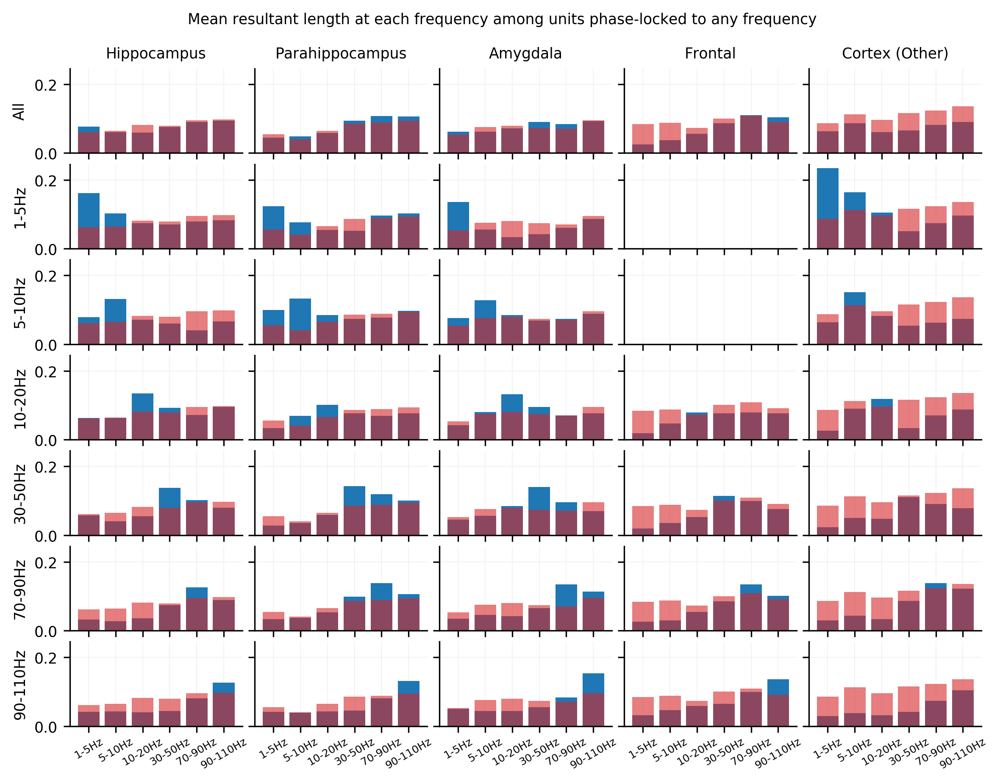

In [208]:
colors = ['C0', 'C2', 'C1', 'C9', 'C3']
cats = list(counts2.keys())
xlabels = ['1-5Hz', '5-10Hz', '10-20Hz', '30-50Hz', '70-90Hz', '90-110Hz']
ylabels = ['All', '1-5Hz', '5-10Hz', '10-20Hz', '30-50Hz', '70-90Hz', '90-110Hz']

insig_lengths = OrderedDict()
insig_lengths['hpc'] = np.array(pl_df.query("(sig==False) & (is_hpc==True)").lengths.tolist()).mean(axis=0)
insig_lengths['phpc'] = np.array(pl_df.query("(sig==False) & (roi==['EC', 'PG'])").lengths.tolist()).mean(axis=0)
insig_lengths['amg'] = np.array(pl_df.query("(sig==False) & (roi=='A')").lengths.tolist()).mean(axis=0)
insig_lengths['fl'] = np.array(pl_df.query("(sig==False) & (roi==['OF', 'AC', 'SMA', 'pSMA'])").lengths.tolist()).mean(axis=0)
insig_lengths['ctx'] = np.array(pl_df.query("(sig==False) & (is_hpc==False) & (roi!=['A', 'EC', 'PG', 'OF', 'AC', 'SMA', 'pSMA'])").lengths.tolist()).mean(axis=0)

fig, ax = plt.subplots(len(cats), 5, sharex=True, sharey=True, figsize=(8, 6), dpi=300)
ax = np.ravel(ax)

i = 0
for j, cat in enumerate(cats):
    for jj, roi in enumerate(rois):
        if len(counts2[cat][roi]) > 0:
            ax[i].bar(np.arange(len(band_names)), np.array(list(counts2[cat][roi].values())))
            ax[i].bar(np.arange(len(band_names)), insig_lengths[roi], alpha=0.6)
        ax[i].set_xticks(np.arange(0, len(band_names)))
        if i >= (len(cats) * len(rois)) - len(rois):
            ax[i].set_xticklabels(xlabels, rotation=30, fontsize=6, y=0.03) 
        if i < len(rois):
            ax[i].set_title(fancy_names[roi])
        if jj == 0:
            ax[i].set_ylabel(ylabels[j])
        i += 1
        
fig.suptitle('Mean resultant length at each frequency among units phase-locked to any frequency', y=1.02)
fig.tight_layout(w_pad=0.05, h_pad=0.05)

## Cell by cell

In [137]:
# Calculate the expected number of oscillations based on chance.
exp_duration_pct = {}
exp_power_pct = {}
exp_osc_pct = {}
osc_length = 3
power_percentile = 25
for band_name, pass_band in bands.items():
    exp_duration_pct[band_name] = np.array([((np.sum(i) / len(i))**osc_length) * (len(i) - (osc_length-1)) / len(i)
                                             for i in cycle_stats[band_name]['duration_mask']])
    exp_power_pct[band_name] = np.array([((1 - (0.01*power_percentile))**osc_length) * (len(i) - (osc_length-1)) / len(i)
                                          for i in cycle_stats[band_name]['power_mask']])
    exp_osc_pct[band_name] = exp_duration_pct[band_name] * exp_power_pct[band_name]

In [106]:
# Get a mapping between cycle values and LFP timepoints
cycles = {}
for cycle_type in ['min', 'max']:
    cycles[cycle_type] = np.array([np.repeat(np.arange(len(x)), repeats=x) for x in cycle_stats[cycle_type]['duration']])

In [682]:
# Divide each theta cycle into 6 bins of equal size.
tmp_inds = [np.linspace(0, x, 7, endpoint=True, dtype=int)[1:] for x in cycle_stats['max']['duration'][0]]
div_inds = tmp_inds[0]
for i in range(1, len(tmp_inds)):
    div_inds = np.append(div_inds, tmp_inds[i] + div_inds[-1])
arr = np.array([np.mean(x) for x in np.split(uphase_max[0, :], div_inds[:-1])])

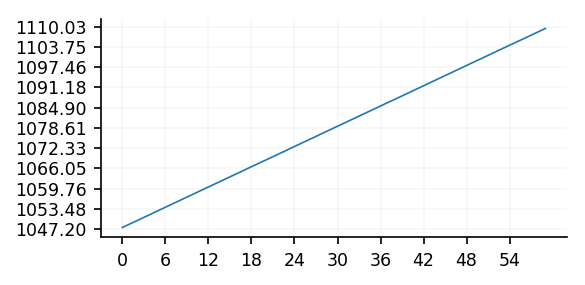

In [686]:
# Proof that theta cycles advance 1 per 6 bins
fig, ax = plt.subplots(1, 1, figsize=(4, 2), dpi=150)
ax = np.ravel(ax)

ax[0].plot(arr[1000:1060])
ax[0].set_xticks(np.arange(0, 60, 6))
ax[0].set_yticks(np.arange((1000/60)*2*np.pi, ((1000/6)*2*np.pi) + (10*2*np.pi), 2*np.pi))
fig.tight_layout()

## Harris et al., Nature 2003

In [244]:
pl_df.spike_inds.tolist()[0]

array([    197,    4627,    6497, ..., 2521619, 2528580, 2533347])

In [249]:
power['low_theta']

(64, 3212809)

In [250]:
power = OrderedDict()
for band_name in band_names:
    power[band_name] = cycles_to_lfp(cycle_stats, cycle_type=band_name, category='power')

NameError: name 'power_bands' is not defined

In [170]:
cycle_stats['low_theta'].keys()
pl_df.loc[2, 'phases']

[array([ 2.21339482e+00,  3.01758242e+00,  2.36415999e+00, ...,
        -1.37287599e+03, -1.40429192e+03, -2.52898209e+03]),
 array([ 2.57039399, -1.96199081,  1.99115027, ...,  1.7588067 ,
         1.88010371,  1.6275721 ]),
 array([-1.40249672,  0.32339924, -0.6425985 , ...,  2.6927937 ,
         2.85307904,  2.56732303]),
 array([-3.14159265,  1.17809725, -1.09590441, ..., -2.86233997,
        -2.16420827,  2.44346095]),
 array([-2.44346095, -1.30899694, -1.3962634 , ...,  1.25663706,
         2.82743339,  3.14159265]),
 array([-0.5543987 , -1.12199738, -1.42799666, ...,  0.92399784,
         2.77199352, -3.14159265])]

In [267]:
# Get session info.
subj_df = get_subj_df()

# Load spikes.
spikes, fr_df, clus_to_chan, chan_to_clus = load_spikes(subj_sess)

# Load the raw LFP.
lfp_raw, lfp_preproc = manning_analysis.process_lfp(subj_sess, 
                                                    subj_df=subj_df, 
                                                    notch_freqs=[60, 120],
                                                    interpolate=True,
                                                    session_spikes=spikes,
                                                    ms_before=2,
                                                    ms_after=4)
sampling_rate = lfp_preproc.samplerate.data.tolist()

# Bandpass filter the LFP.
lfp_filt = filter_lfp_bands(lfp_preproc, 
                            bands=bands, 
                            zscore_lfp=True)

# Use a derivative test to identify troughs and peaks in the filtered 
# LFP, then linearly interpolate phase between cycles.
phase = get_phase_bands(lfp_filt, 
                        bands=bands, 
                        find='peaks', 
                        lims=[-np.pi, np.pi])

In [276]:
np.array_equal(phase[band_name]['inds'][1][phase[band_name]['inds'][0]==0], np.cumsum(cycle_stats[band_name]['duration'][0])[:-1])

True

In [280]:
pl_df.columns

Index(['subj_sess', 'unit', 'chan', 'hem', 'roi', 'hemroi', 'is_hpc',
       'spike_inds', 'phases', 'means', 'lengths', 'pvals', 'sig', 'sigs',
       'pval_argmin', 'length_argmax', 'locked_band', 'locked_phase',
       'locked_length', 'locked_pval', 'locked_bands', 'locked_phases',
       'locked_lengths', 'locked_pvals', 'n_locked'],
      dtype='object')

In [256]:
cycles_to_lfp(cycle_stats, channel=0, cycle_type=band_name, category='duration')

array([16, 16, 16, ..., 19, 19, 19])

In [281]:
band_names

array(['low_theta', 'high_theta', 'alpha_beta', 'low_gamma', 'mid_gamma',
       'high_gamma'], dtype='<U10')

In [302]:
def calc_spike_fr_power(subj_sess, band_names=None):
    """Get firing rate and band powers at spike times for each unit."""
    if band_names is None:
        band_names = ['low_theta', 'high_theta', 'alpha_beta', 'low_gamma', 'mid_gamma', 'high_gamma']
        
    # Load spikes.
    spikes, fr_df, clus_to_chan, chan_to_clus = load_spikes(subj_sess)
    units = fr_df.clus.tolist()
    
    # Load cycle_stats.
    cycle_stats = open_pickle(os.path.join('/scratch/dscho/phase_precession/data/cycle_stats', 
                                           '{}_cycle_stats_peaks_25powpct_3osclength.pkl'.format(subj_sess)))
    
    # Load phase-locking DataFrame.
    pl_df = open_pickle(os.path.join('/scratch/dscho/phase_precession/data/phase_locking',
                                     '{}_phase_locking_df_no_mask_peaks_25powpct_3osclength.pkl'.format(subj_sess)))
    
    # Get power.
    power = OrderedDict()
    for band_name in band_names:
        power[band_name] = cycles_to_lfp(cycle_stats, cycle_type=band_name, category='power')
        
    spike_ifrs = []
    spike_powers = []
    for unit in units:
        chan = fr_df.at[unit, 'chan']
        chan_ind = int(chan) - 1
        spike_inds = pl_df.loc[unit, 'spike_inds']
        
        # Get instantaneous firing rate (sum of spikes over 3 cycles).
        spike_train = fr_df.loc[unit, 'spikes']
        cycle_inds = np.cumsum(cycle_stats['low_theta']['duration'][chan_ind])[:-1]
        cycle_spikes = np.array([np.sum(arr) for arr in np.split(spike_train, cycle_inds)])
        cycle_ifr = np.append(np.array([0]), rolling_func(cycle_spikes, f=np.sum, window=3, right_fill=0)[:-1])
        ifr = cycles_to_lfp(cycle_stats, arr=cycle_ifr, channel=chan_ind, cycle_type='low_theta')
        spike_ifrs.append(ifr[spike_inds])
        
        spike_powers_ = []
        for band_name in band_names:
            spike_powers_.append(power[band_name][chan_ind, spike_inds])
        spike_powers.append(np.array(spike_powers_))
            
    pl_df['spike_ifrs'] = spike_ifrs
    pl_df['spike_powers'] = spike_powers
        
    return pl_df

In [347]:
start_time = time()
pl_df2 = calc_spike_fr_power('U371_env2')
print('Done in {:.0f} secs.'.format(time() - start_time))

Done in 41 secs.


In [305]:
np.array(pl_df2.loc[i, 'phases'])[0, :]

array([ 1.85863859e+00,  1.81343966e+00,  3.03942704e+00, ...,
       -1.90694674e+03, -1.93207948e+03, -3.83588463e+03])

In [314]:
min(np.array(pl_df2.loc[0, 'phases'])[0, :])

-3835.8846300331375

In [348]:
pl_df.query("(is_hpc==True) & (locked_band=='low_theta') & (subj_sess=='U371_env2')")

,subj_sess,unit,chan,hem,roi,hemroi,is_hpc,spike_inds,phases,means,...,length_argmax,locked_band,locked_phase,locked_length,locked_pval,locked_bands,locked_phases,locked_lengths,locked_pvals,n_locked
104,U371_env2,1,17,R,MH,RMH,True,"[2040, 2691, 3038, 3153, 4535, 5049, 5942, 665...","[[-0.37409489985128097, -0.13274335156013173, ...","[0.6913375672691919, 0.15850050303813337, -0.2...",...,0,low_theta,0.691338,0.112437,7.965477e-52,"[low_theta, high_theta, low_gamma, mid_gamma, ...","[0.6913375672691919, 0.15850050303813337, 2.58...","[0.1124367511131417, 0.05555080510439978, 0.04...","[7.9654765056544e-52, 8.02788961252342e-12, 2....",5
125,U371_env2,22,44,L,PH,LPH,True,"[441, 455, 687, 2158, 3142, 4851, 6677, 6698, ...","[[-2.1487479164691434, -2.0472893301940402, -1...","[-0.7083436093212238, -0.32043604663641206, 2....",...,0,low_theta,-0.708344,0.090562,1.750605e-07,"[low_theta, high_theta, low_gamma]","[-0.7083436093212238, -0.32043604663641206, 1....","[0.09056180941167721, 0.06324363576947267, 0.0...","[1.7506050297815513e-07, 0.0012413022615583933...",3
126,U371_env2,23,44,L,PH,LPH,True,"[741, 3466, 6408, 12629, 13799, 13883, 16702, ...","[[-1.4530318962970092, 0.025364646568775573, -...","[-1.0595752580428757, -0.03284623613480174, 1....",...,0,low_theta,-1.059575,0.103560,1.202310e-16,"[low_theta, low_gamma, mid_gamma, high_gamma]","[-1.0595752580428757, 1.4148586108262602, 0.79...","[0.10356025765277398, 0.07062436010112445, 0.0...","[1.2023100178021247e-16, 1.8091409557599298e-0...",4
129,U371_env2,26,48,L,PH,LPH,True,"[9381, 9886, 10019, 11358, 11592, 23108, 23673...","[[-1.3086032557058238, -0.05196619426990656, 2...","[-2.4707373300076303, -2.0257555101211966, -2....",...,5,low_theta,-2.470737,0.108027,3.910878e-06,"[low_theta, low_gamma, mid_gamma, high_gamma]","[-2.4707373300076303, 2.9418202870163386, 1.69...","[0.10802716095384826, 0.07785396708341943, 0.0...","[3.910878118287085e-06, 0.00751074337186323, 0...",4


In [368]:
pl_df2['gamma_ratio'] = pl_df2.spike_powers.apply(lambda x: x[4, :] / x[3, :])

In [ ]:
pl_df2.loc[i, 'spike_powers'][4, :] / pl_df2.loc[i, 'spike_powers'][3, :]

(-3, 3)

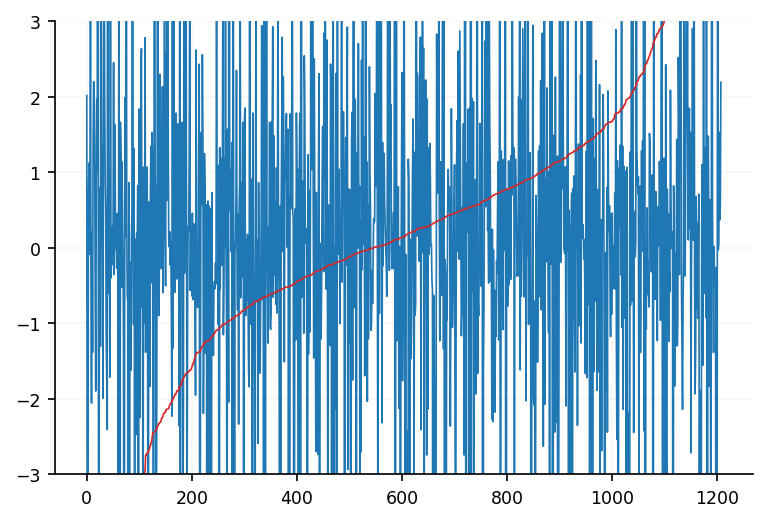

In [366]:
fig, ax = plt.subplots()
ax = np.ravel(ax)
ax[0].plot(pl_df2.loc[i, 'spike_powers'][4, :] / pl_df2.loc[i, 'spike_powers'][3, :])
ax[0].plot(np.sort(pl_df2.loc[i, 'spike_powers'][4, :] / pl_df2.loc[i, 'spike_powers'][3, :]))
ax[0].set_ylim([-3, 3])

(-3.141592653589793, 3.141592653589793)

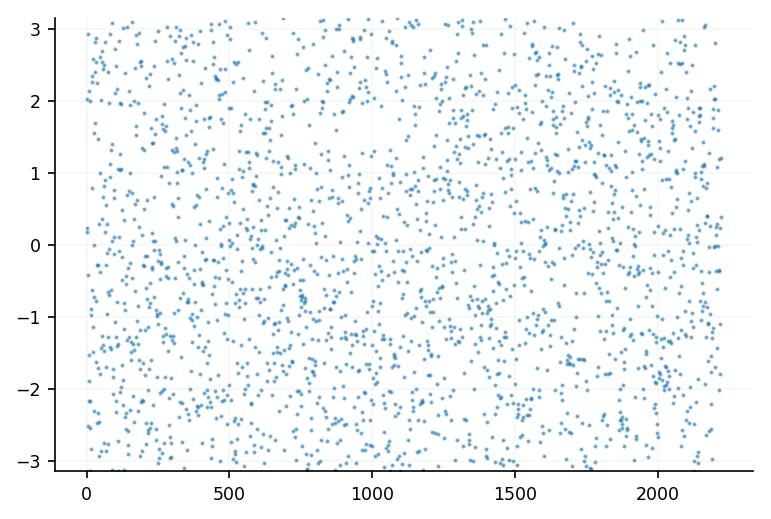

In [372]:
i = 22

fig, ax = plt.subplots()
ax = np.ravel(ax)

#xsort = pl_df2.loc[i, 'spike_ifrs'].argsort()
xsort = pl_df2.loc[i, 'gamma_ratio'].argsort()
#ax[0].plot(pl_df2.loc[i, 'spike_ifrs'][xsort])
#ax[0].plot(pl_df2.loc[i, 'gamma_ratio'][xsort])
ax[0].plot(np.array(pl_df2.loc[i, 'phases'])[0, xsort], linewidth=0, marker='.', markersize=2, alpha=0.5)
ax[0].set_ylim([-np.pi, np.pi])

In [301]:
i = 12
np.array(pl_df2.loc[i, 'phases']).shape, pl_df2.loc[i, 'spike_ifrs'].shape, pl_df2.loc[i, 'spike_powers'].shape

((6, 4807), (4807,), (6, 4807))

In [845]:
# Get instantaneous firing rate (number of spikes within one theta cycle of each spike)
cycle_type = 'low_theta'
phase = phase_max

xinds, yinds = cycle_inds[cycle_type]
hpc_rois = ['LAH', 'LMH', 'LPH', 'RAH', 'RMH', 'RPH']
corrs = OrderedDict()
spike_phases_lowfr = OrderedDict()
spike_phases_highfr = OrderedDict()
for unit in units:
    spike_train = fr_df.loc[unit, 'spikes']
    n_timepoints = len(spike_train)
    chan = fr_df.at[unit, 'chan']
    chan_ind = int(chan) - 1
    hemroi = fr_df.at[unit, 'location']
    hem = hemroi[0]
    roi = hemroi[1:]
    is_hpc = hemroi in hpc_rois
    
    # Get the number of spikes per cycle and the instantaneous firing rate
    # (number of spikes over a 3-cycle sliding window).
    yinds_ = yinds[xinds==chan_ind] # Indices that divide each cycle
    cycle_spikes = np.array([np.sum(arr) for arr in np.split(spike_train, yinds_)])
    ifr = np.append(np.array([0]), rolling_func(cycle_spikes, f=np.sum, window=3, right_fill=0)[:-1])
    cycle_spikes = cycles_to_lfp(cycle_stats, arr=cycle_spikes, channel=chan_ind, cycle_type=cycle_type)
    ifr = cycles_to_lfp(cycle_stats, arr=ifr, channel=chan_ind, cycle_type=cycle_type)
    
    # Collect phases and instantaneous firing rates for spikes that meet criteria.
    #spike_inds = np.where(osc_mask[chan_ind, :] * spike_train)[0]
    spike_inds = np.where(spike_train)[0]
    if (len(spike_inds) > 50):
        spike_phases = convert_radians(phase[chan_ind, spike_inds])
        #spike_phases = phase[chan_ind, spike_inds]
        spike_ifrs = ifr[spike_inds]
        corrs[unit] = stats.pearsonr(spike_ifrs, spike_phases)
        
        spike_phases_lowfr_ = spike_phases[spike_ifrs<=3]
        spike_phases_highfr_ = spike_phases[spike_ifrs>3]
        
        if np.all((len(spike_phases_lowfr_)>30, len(spike_phases_highfr_)>30)):
            spike_phases_lowfr[unit] = [len(spike_phases_lowfr_)] + list(circstats.circmoment(spike_phases_lowfr_)) + [circstats.rayleightest(spike_phases_lowfr_)]
            spike_phases_highfr[unit] = [len(spike_phases_highfr_)] + list(circstats.circmoment(spike_phases_highfr_)) + [circstats.rayleightest(spike_phases_highfr_)]

In [869]:
low_angles = []
high_angles = []
for unit in spike_phases_lowfr.keys():
    low_n, low_angle, low_length, low_p = spike_phases_lowfr[unit]
    high_n, high_angle, high_length, high_p = spike_phases_highfr[unit]
    low_angle = convert_radians(low_angle)
    high_angle = convert_radians(high_angle)
    if (low_p<0.05) or (high_p<0.05):
        low_angles.append(low_angle)
        high_angles.append(high_angle)

(array([6., 4., 1., 1., 8., 0., 5., 2., 2., 6.]),
 array([0.05413307, 0.65677842, 1.25942377, 1.86206912, 2.46471447,
        3.06735982, 3.67000516, 4.27265051, 4.87529586, 5.47794121,
        6.08058656]),
 <a list of 10 Patch objects>)

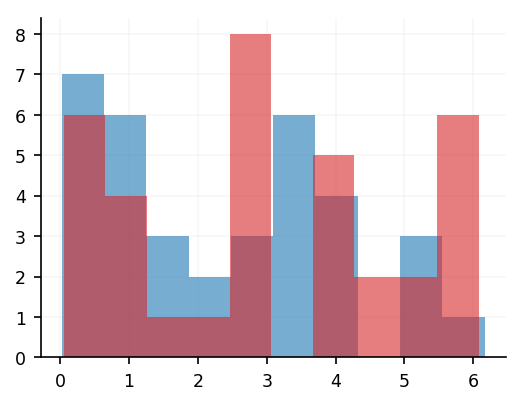

In [870]:
fig, ax = plt.subplots(1, 1, sharex=False, figsize=(4, 3), dpi=150)
ax = np.ravel(ax)

ax[0].hist(np.array(low_angles), alpha=0.6)
ax[0].hist(np.array(high_angles), alpha=0.6)

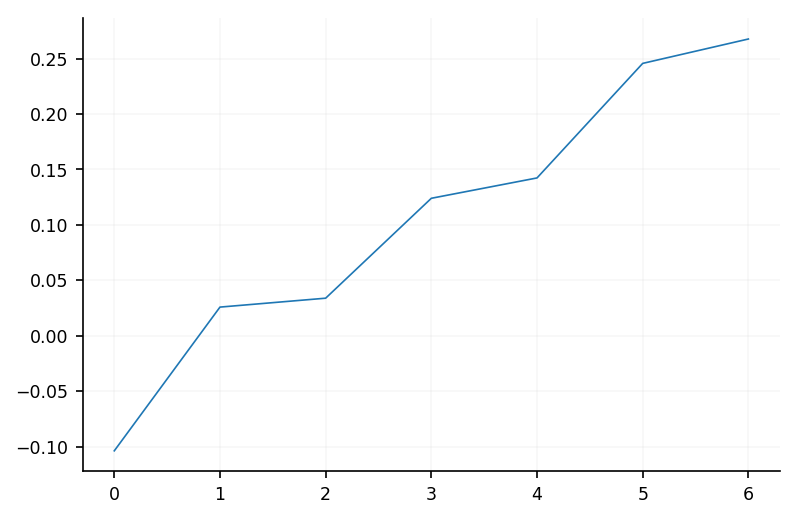

In [802]:
plt.plot(np.sort([x[0] for x in corrs.values()]))

(0.025923854847773792, 0.7861448588989348)

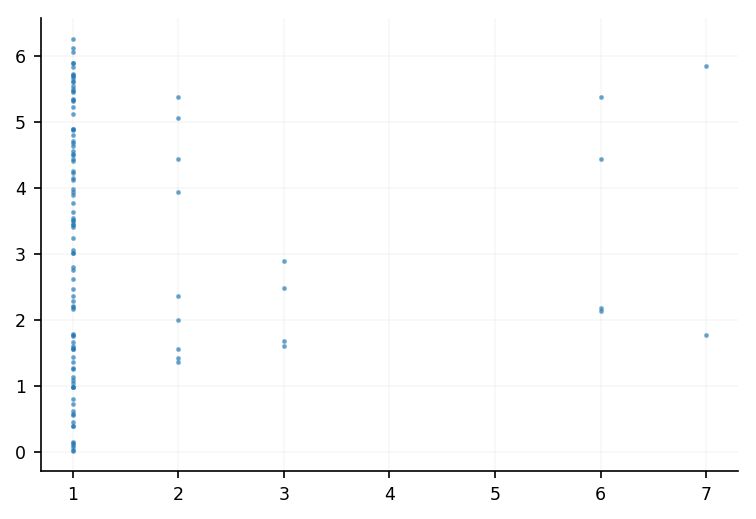

In [803]:
plt.scatter(spike_ifrs, spike_phases, s=2, alpha=0.5)
stats.pearsonr(spike_ifrs, spike_phases)

Text(0.5,1,'Spikes per cycle and instantaneous firing rate (3-cycle rolling sum)')

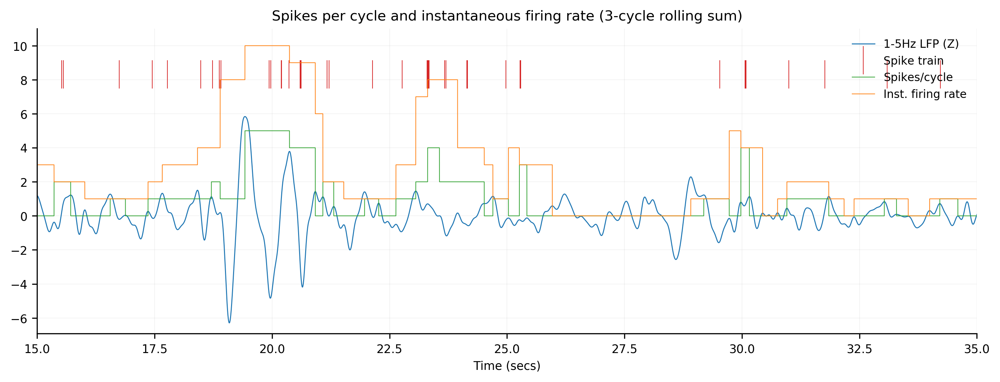

In [742]:
i = 0
fig, ax = plot_trace(np.stack((lfp_proc_z[i, :], spike_train, cycle_spikes, ifr)), start=15, duration=20, x_units='secs', 
                     markers=[None, '|', None, None], linewidths = [0.7]+[0.5]*3, markeredgewidths=[0.5]*4, 
                     legend_labels = ['1-5Hz LFP (Z)', 'Spike train', 'Spikes/cycle', 'Inst. firing rate'], dpi=300)
ax[0].set_title('Spikes per cycle and instantaneous firing rate (3-cycle rolling sum)', fontsize=10)

In [711]:
np.unique(spike_cycles

array([   1,    2,    6, ..., 4404, 4404, 4412])

In [710]:
rolling_func(spike_cycles, f=np.sum, window=3, right_fill=0)

(1890,)

## __________END Harris et al_________

In [432]:
# Get masks the fit the LFP 
osc_start_mask = cycles_to_lfp(cycle_stats, category='osc_start_mask', cycle_type='min')
osc_mask = cycles_to_lfp(cycle_stats, category='osc_mask', cycle_type='min')
powdur_mask = cycles_to_lfp(cycle_stats, category='powdur_mask', cycle_type='min')
power_mask = cycles_to_lfp(cycle_stats, category='power_mask', cycle_type='min')
duration_mask = cycles_to_lfp(cycle_stats, category='duration_mask', cycle_type='min')

In [128]:
fr_df.head()

,subj_sess,chan,location,pct_interp,clus,chan_clus,mean_fr,fr,spikes,interp_mask
0,U369_env1,1,RA,0.009445,0,0,1.490372,"[0.0008436540078203249, 0.0008445737773282454,...","[False, False, False, False, False, False, Fal...","[False, False, False, False, False, False, Fal..."
1,U369_env1,2,RA,0.021888,1,0,3.468861,"[0.0019127166196549615, 0.0019156665058771357,...","[False, False, False, False, False, False, Fal...","[False, False, False, False, False, False, Fal..."
2,U369_env1,4,RA,0.017023,2,0,2.295489,"[0.0008436540078203249, 0.0008445737773282454,...","[False, False, False, False, False, False, Fal...","[False, False, False, False, False, False, Fal..."
3,U369_env1,4,RA,0.017023,3,1,0.404530,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[False, False, False, False, False, False, Fal...","[False, False, False, False, False, False, Fal..."
4,U369_env1,5,RA,0.050652,4,0,7.940767,"[0.0019739802908950994, 0.0019772106313837, 0....","[False, False, False, False, False, False, Fal...","[False, False, False, False, False, False, Fal..."


In [517]:
min_phases = 50 # >=min_phases spikes must remain after masking for analysis to be done

hpc_rois = ['LAH', 'LMH', 'LPH', 'RAH', 'RMH', 'RPH']
spike_inds = {}
phases = {}
uphases = {}
pvals = {}
for cycle_type in ['min', 'max', 'hilbert']:
    spike_inds[cycle_type] = OrderedDict()
    phases[cycle_type] = OrderedDict()
    uphases[cycle_type] = OrderedDict()
    pvals[cycle_type] = OrderedDict()
    for unit in units:
        spike_train = fr_df.loc[unit, 'spikes']
        n_timepoints = len(spike_train)
        chan = fr_df.at[unit, 'chan']
        chan_ind = int(chan) - 1
        hemroi = fr_df.at[unit, 'location']
        hem = hemroi[0]
        roi = hemroi[1:]
        is_hpc = hemroi in hpc_rois
        
        # Collect phases of spike times that meet criteria.
        spike_inds_ = np.flatnonzero(osc_mask[chan_ind, :] * spike_train)
        
        if len(spike_inds_) > min_phases:
            spike_inds[cycle_type][unit] = spike_inds_
            if cycle_type == 'min':
                phases[cycle_type][unit] = phase_min[chan_ind, spike_inds_]
                uphases[cycle_type][unit] = uphase_min[chan_ind, spike_inds_]
            elif cycle_type == 'max':
                phases[cycle_type][unit] = phase_max[chan_ind, spike_inds_]
                uphases[cycle_type][unit] = uphase_max[chan_ind, spike_inds_]
            elif cycle_type == 'hilbert':
                phases[cycle_type][unit] = phase_hilbert[chan_ind, spike_inds_]
    
            pvals[cycle_type][unit] = circstats.rayleightest(phases[cycle_type][unit])

In [416]:
# no mask
x = 3
print(np.sum(pvals['min']<(0.05/x)), np.sum(pvals['max']<(0.05/x)), np.sum(pvals['hilbert']<(0.05/x)))
print(int(np.array([len(x) for x in phases['min']]).mean()))

23 24 19
5835


In [418]:
# osc_start_mask
x = 3
print(np.sum(pvals['min']<(0.05/x)), np.sum(pvals['max']<(0.05/x)), np.sum(pvals['hilbert']<(0.05/x)))
print(int(np.array([len(x) for x in phases['min']]).mean()))

9 22 24
1229


In [437]:
# osc_mask
x = 3
print(np.sum(pvals['min']<(0.05/x)), np.sum(pvals['max']<(0.05/x)), np.sum(pvals['hilbert']<(0.05/x)))
print(int(np.array([len(x) for x in phases['min']]).mean()))

15 24 30
2189


In [435]:
# powdur_mask
x = 3
print(np.sum(pvals['min']<(0.05/x)), np.sum(pvals['max']<(0.05/x)), np.sum(pvals['hilbert']<(0.05/x)))
print(int(np.array([len(x) for x in phases['min']]).mean()))

16 36 41
3712


In [424]:
# power_mask
x = 3
print(np.sum(pvals['min']<(0.05/x)), np.sum(pvals['max']<(0.05/x)), np.sum(pvals['hilbert']<(0.05/x)))
print(int(np.array([len(x) for x in phases['min']]).mean()))

20 27 30
4495


In [426]:
# duration_mask
x = 3
print(np.sum(pvals['min']<(0.05/x)), np.sum(pvals['max']<(0.05/x)), np.sum(pvals['hilbert']<(0.05/x)))
print(int(np.array([len(x) for x in phases['min']]).mean()))

20 32 35
4561


In [274]:
n_bootstrap = 1000

bs_pvals = []
for iunit in range(len(phases)):
    bootstraps = []
    v = phases[iunit].copy()
    for i in range(n_bootstrap):
        np.random.shuffle(v)
        bootstraps.append(circstats.rayleightest(v[:len(phases2[iunit])]))
    xsort = np.array(bootstraps)
    bs_pvals.append((np.sum(np.array(bootstraps) < pvals2[iunit]) + 1) / (n_bootstrap + 1))
bs_pvals = np.array(bs_pvals)

## Plots

Text(0.5,1,'Trough/Peak identification for 1-5Hz filtered LFP')

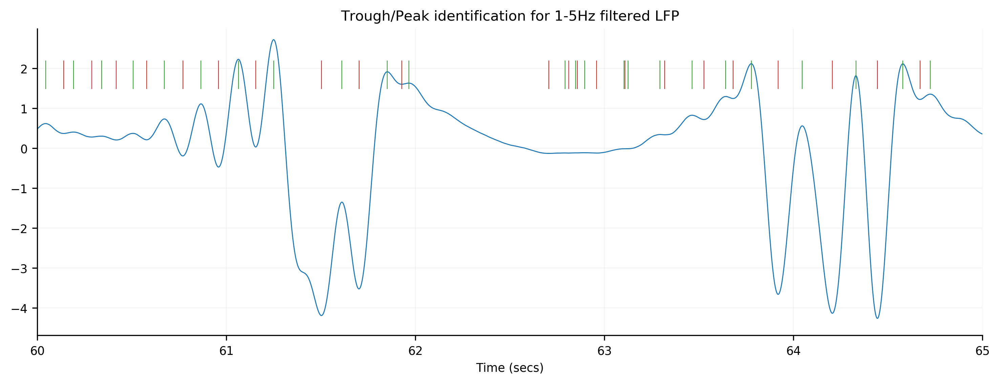

In [129]:
i = 44
fig, ax = plot_trace(np.stack((lfp_proc_z[i, :], minima[i, :], maxima[i, :])), start=60, duration=5, x_units='secs', 
                     markers=[None, '|', '|'], linewidths = [0.7]*3, markeredgewidths=[0.5]*3, dpi=300)
ax[0].set_title('Trough/Peak identification for 1-5Hz filtered LFP', fontsize=10)

Text(0.5,1,'Trough/Peak identification for 1-5Hz filtered LFP')

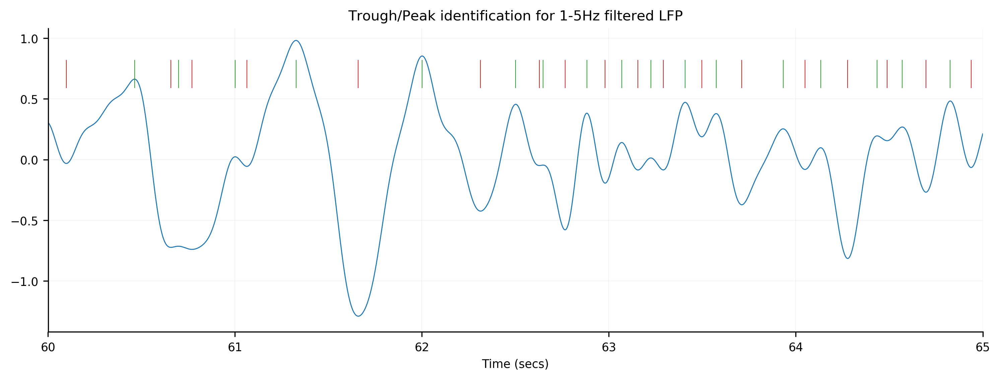

In [130]:
i = 40
fig, ax = plot_trace(np.stack((lfp_proc_z[i, :], minima[i, :], maxima[i, :])), start=60, duration=5, x_units='secs', 
                     markers=[None, '|', '|'], linewidths = [0.7]*3, markeredgewidths=[0.5]*3, dpi=300)
ax[0].set_title('Trough/Peak identification for 1-5Hz filtered LFP', fontsize=10)

Text(0.5,1,'Trough/peak linear interpolation of phase (1-5Hz filtered LFP)')

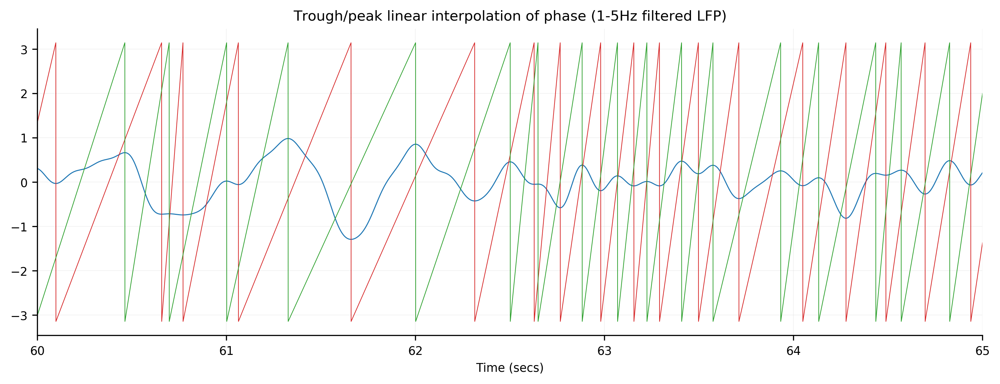

In [137]:
i = 40
fig, ax = plot_trace(np.stack((lfp_proc_z[i, :], phase_min[i, :], phase_max[i, :])), start=60, duration=5, x_units='secs', 
                     linewidths=[0.7] + [0.5]*3, dpi=300)
ax[0].set_title('Trough/peak linear interpolation of phase (1-5Hz filtered LFP)', fontsize=10)

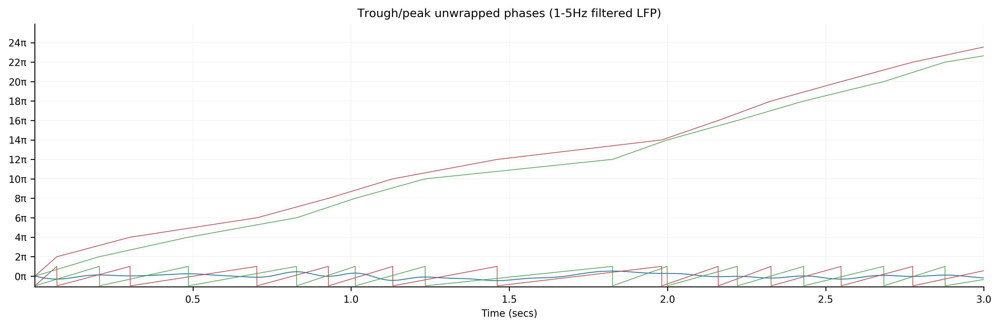

In [180]:
i = 40
fig, ax = plot_trace(np.stack((lfp_proc_z[i, :], phase_min[i, :], phase_max[i, :], uphase_min[i, :], uphase_max[i, :])), 
                     start=0, duration=3, x_units='secs', colors=['C0', 'C1', 'C2', 'C1', 'C2'], linewidths=[0.7] + [0.5]*4, dpi=300)
ax[0].set_yticks(np.arange(0, 80, 2 * np.pi))
ax[0].set_yticklabels(['{}π'.format(2*i) for i in range(len(np.arange(0, 80, 2 * np.pi)))])
ax[0].set_title('Trough/peak unwrapped phases (1-5Hz filtered LFP)', fontsize=10)
fig.tight_layout()

Text(0.5,1,'Hilbert transform of filtered LFP')

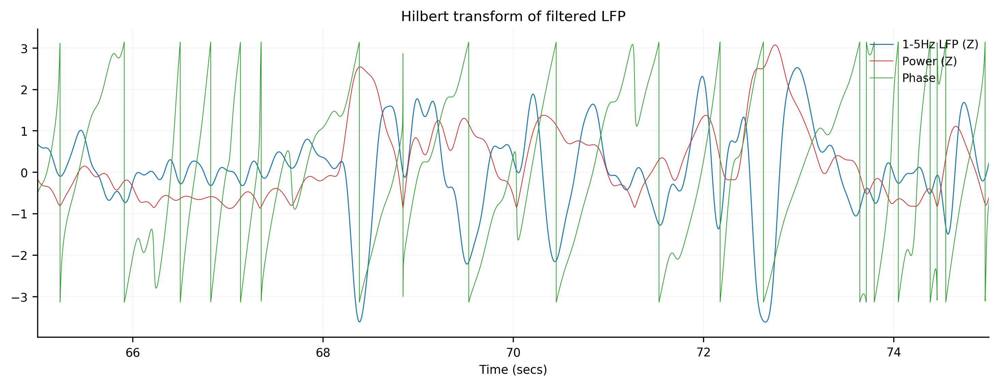

In [136]:
i = 0
fig, ax = plot_trace(np.stack((lfp_proc_z[i, :], power_z[i, :], phase[i, :])), start=65, duration=10, x_units='secs', 
                     linewidths=[0.7] + [0.5]*2, legend_labels = ['1-5Hz LFP (Z)', 'Power (Z)', 'Phase'], dpi=300)
ax[0].set_title('Hilbert transform of filtered LFP', fontsize=10)

Text(0.5,1,'Mean power and duration for each cycle')

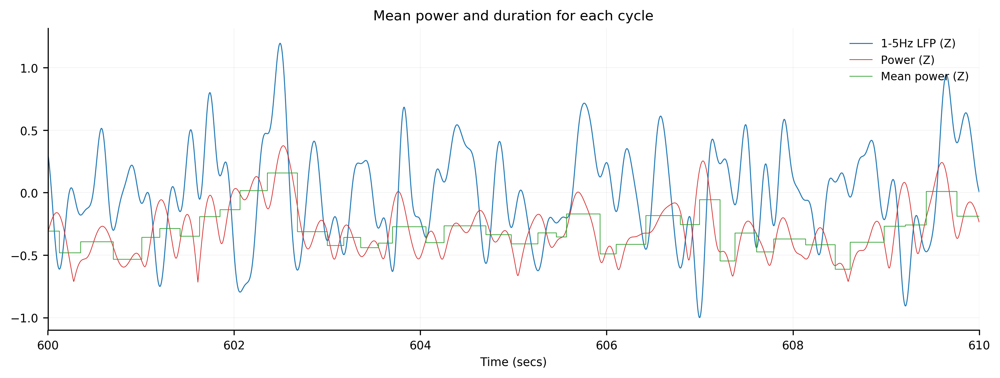

In [47]:
xind = 40
    
fig, ax = plot_trace(np.stack((lfp_proc_z[xind, :], power_z[xind, :], cycles_to_lfp(cycle_stats, xind, 'power'))), 
                     start=600, duration=10, x_units='secs', 
                     linewidths=[0.7] + [0.5]*2, legend_labels=['1-5Hz LFP (Z)', 'Power (Z)', 'Mean power (Z)'], dpi=300)
ax[0].set_title('Mean power and duration for each cycle', fontsize=10)

Text(0.5,1,'Oscillation detection')

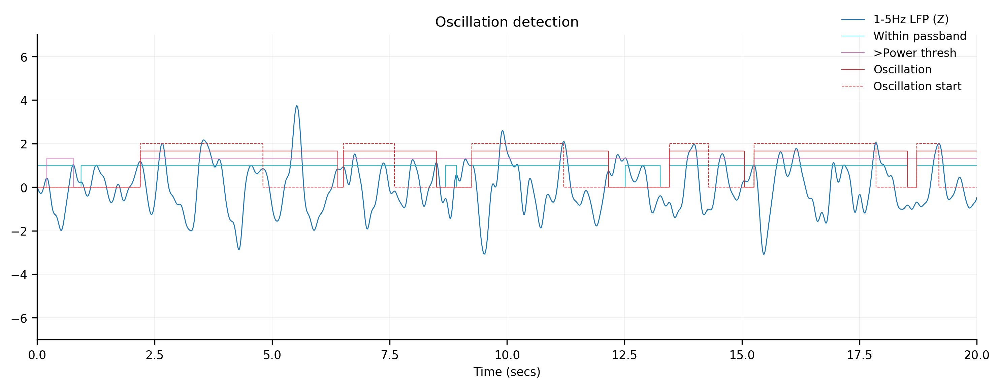

In [140]:
xind = 10
band_name = 'low_theta'
fig, ax = plot_trace(np.stack((lfp_filt[band_name][xind, :], 
                               cycles_to_lfp(cycle_stats, channel=xind, category='duration_mask', cycle_type=band_name) * 1, 
                               cycles_to_lfp(cycle_stats, channel=xind, category='power_mask', cycle_type=band_name) * 1.33, 
                               cycles_to_lfp(cycle_stats, channel=xind, category='osc_mask', cycle_type=band_name) * 1.66, 
                               cycles_to_lfp(cycle_stats, channel=xind, category='osc_start_mask', cycle_type=band_name) * 2)), 
                     start=0, duration=20, x_units='secs', dpi=300,
                     linewidths=[0.7] + [0.5]*4, linestyles=['-']*4 + ['--'], colors=['C0', 'C9', 'C6', 'C1', 'C1'], 
                     legend_labels=['1-5Hz LFP (Z)', 'Within passband', '>Power thresh', 'Oscillation', 'Oscillation start'])
ax[0].set_ylim([-7, 7])
ax[0].set_title('Oscillation detection', fontsize=10)

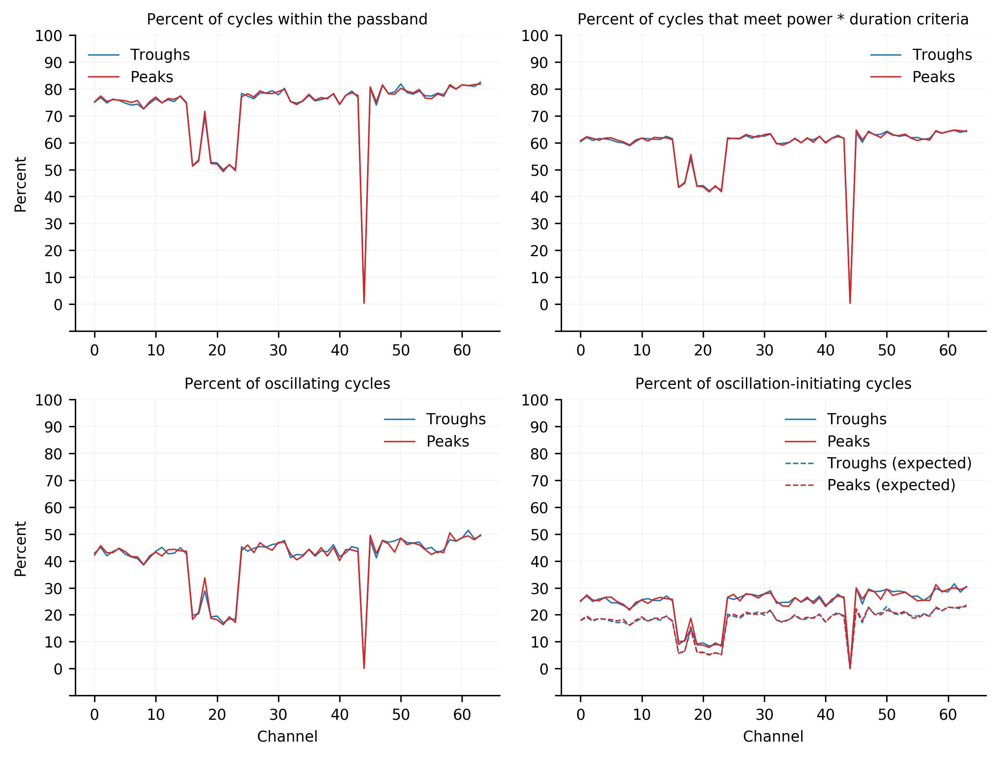

In [100]:
cycle_type = 'min'

fig, ax = plt.subplots(2, 2, figsize=(8, 6), dpi=300)
ax = np.ravel(ax)

i = 0
ax[i].plot([np.sum(x)/len(x) for x in cycle_stats['min']['duration_mask']], color='C0', label='Troughs')
ax[i].plot([np.sum(x)/len(x) for x in cycle_stats['max']['duration_mask']], color='C1', label='Peaks')
ax[i].legend()
ax[i].set_title('Percent of cycles within the passband')

i = 1
ax[i].plot([np.sum(x)/len(x) for x in cycle_stats['min']['powdur_mask']], color='C0', label='Troughs')
ax[i].plot([np.sum(x)/len(x) for x in cycle_stats['max']['powdur_mask']], color='C1', label='Peaks')
ax[i].legend()
ax[i].set_title('Percent of cycles that meet power * duration criteria')

i = 2
ax[i].plot([np.sum(x)/len(x) for x in cycle_stats['min']['osc_mask']], color='C0', label='Troughs')
ax[i].plot([np.sum(x)/len(x) for x in cycle_stats['max']['osc_mask']], color='C1', label='Peaks')
ax[i].legend()
ax[i].set_title('Percent of oscillating cycles')

i = 3
ax[i].plot([np.sum(x)/len(x) for x in cycle_stats['min']['osc_start_mask']], color='C0', label='Troughs')
ax[i].plot([np.sum(x)/len(x) for x in cycle_stats['max']['osc_start_mask']], color='C1', label='Peaks')
ax[i].plot(exp_osc_pct['min'], color='C0', linestyle='--', label='Troughs (expected)')
ax[i].plot(exp_osc_pct['max'], color='C1', linestyle='--', label='Peaks (expected)')
ax[i].legend()
ax[i].set_title('Percent of oscillation-initiating cycles')

for i in range(4):
    ax[i].set_ylim([-0.1, 1.0])
    ax[i].set_yticks(np.arange(-0.1, 1.01, 0.1))
    ax[i].set_yticklabels([''] + [int(x*100) for x in np.arange(0, 1.01, 0.1)])
    
for i in [2, 3]:
    ax[i].set_xlabel('Channel')
    
for i in [0, 2]:
    ax[i].set_ylabel('Percent')
    
fig.tight_layout()

Text(0.5,1,'Mean power and duration for each cycle (1-5Hz filtered LFP)')

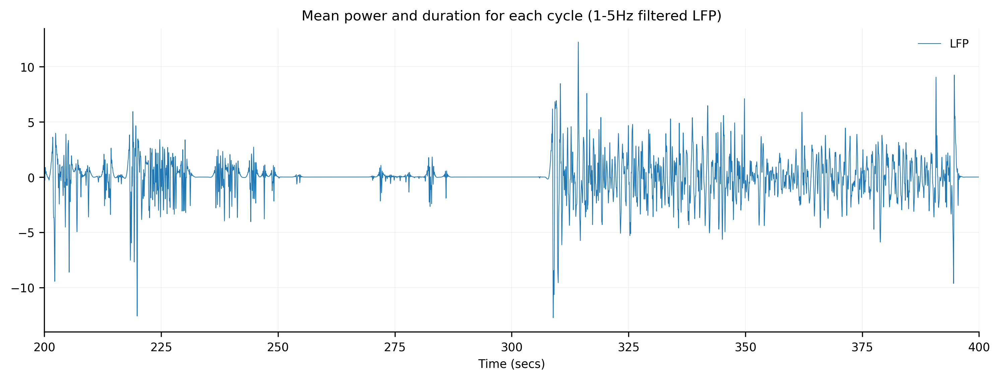

In [139]:
# 44 IS A BAD CHANNEL!
xind = 44
    
fig, ax = plot_trace(np.expand_dims(lfp_proc_z[xind, :], 0), start=200, duration=200, x_units='secs', 
                     linewidths=[0.5], legend_labels=['LFP'], dpi=300)
ax[0].set_title('Mean power and duration for each cycle (1-5Hz filtered LFP)', fontsize=10)

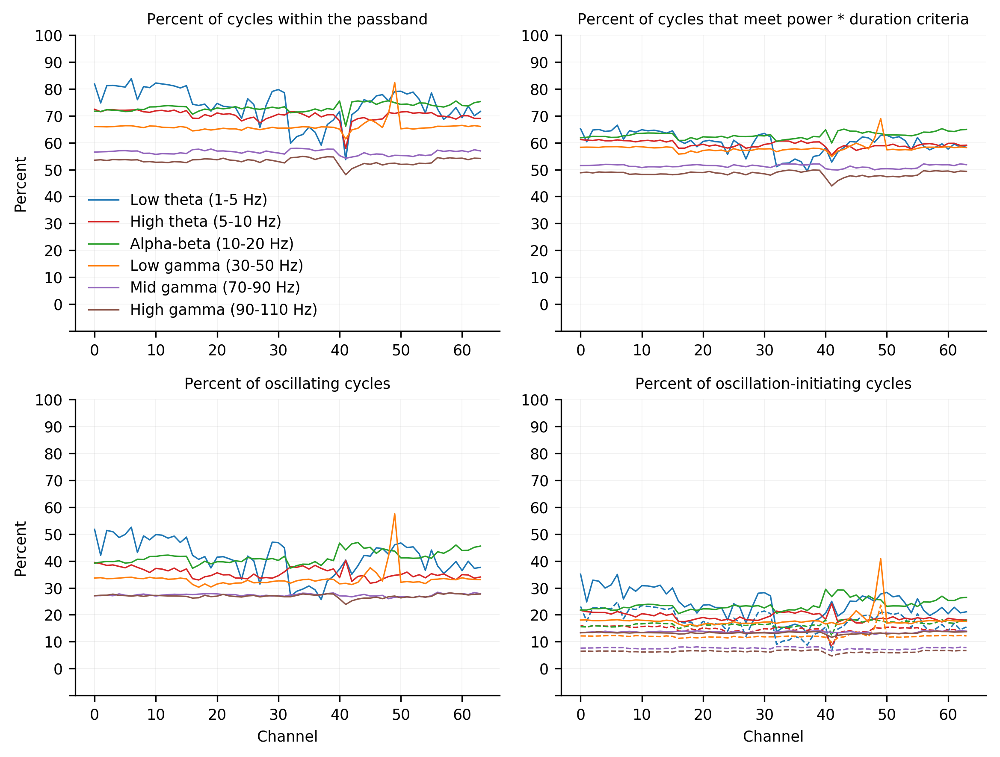

In [138]:
cycle_type = 'min'

fig, ax = plt.subplots(2, 2, figsize=(8, 6), dpi=300)
ax = np.ravel(ax)

i = 0
for band_name, pass_band in bands.items():
    ax[i].plot([np.sum(x)/len(x) for x in cycle_stats[band_name]['duration_mask']], label=bands_fancy[band_name])
ax[i].legend()
ax[i].set_title('Percent of cycles within the passband')

i = 1
for band_name, pass_band in bands.items():
    ax[i].plot([np.sum(x)/len(x) for x in cycle_stats[band_name]['powdur_mask']], label=bands_fancy[band_name])
#ax[i].legend()
ax[i].set_title('Percent of cycles that meet power * duration criteria')

i = 2
for band_name, pass_band in bands.items():
    ax[i].plot([np.sum(x)/len(x) for x in cycle_stats[band_name]['osc_mask']], label=bands_fancy[band_name])
#ax[i].legend()
ax[i].set_title('Percent of oscillating cycles')

i = 3
ii = 0
for band_name, pass_band in bands.items():
    ax[i].plot([np.sum(x)/len(x) for x in cycle_stats[band_name]['osc_start_mask']], color='C{}'.format(ii), label=bands_fancy[band_name])
    ax[i].plot(exp_osc_pct[band_name], color='C{}'.format(ii), linestyle='--')
    ii += 1
#ax[i].legend()
ax[i].set_title('Percent of oscillation-initiating cycles')

for i in range(4):
    ax[i].set_ylim([-0.1, 1.0])
    ax[i].set_yticks(np.arange(-0.1, 1.01, 0.1))
    ax[i].set_yticklabels([''] + [int(x*100) for x in np.arange(0, 1.01, 0.1)])
    
for i in [2, 3]:
    ax[i].set_xlabel('Channel')
    
for i in [0, 2]:
    ax[i].set_ylabel('Percent')
    
fig.tight_layout()

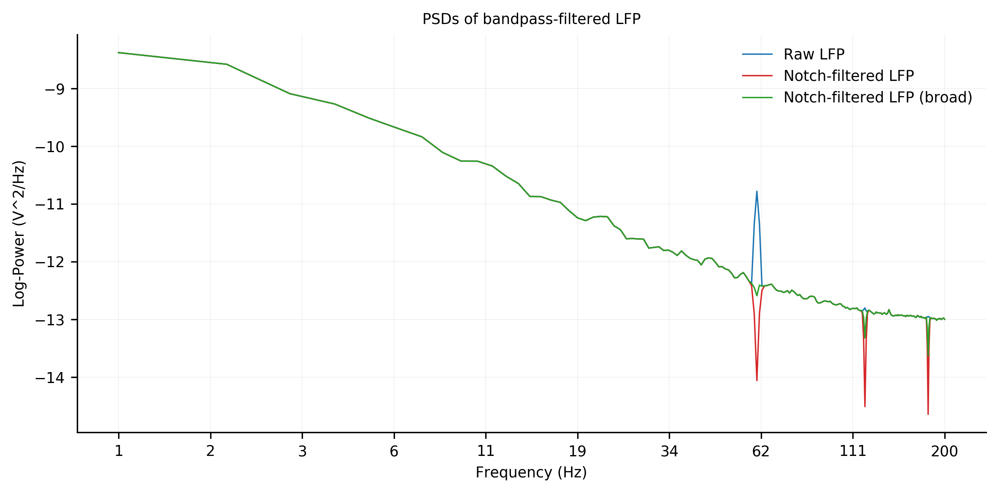

In [978]:
i = 40
freq_means1, P_means1 = neurodsp.spectral.psd(lfp_raw.data[i, :], Fs=2000)
freq_means2, P_means2 = neurodsp.spectral.psd(lfp_proc[i, :], Fs=2000)

fig, ax = plt.subplots(1, 1, figsize=(8, 4), dpi=300)
ax = np.ravel(ax)

ax[0].plot(np.log10(freq_means1[1:201]), np.log10(P_means1[1:201]), label='Raw LFP')
ax[0].plot(np.log10(freq_means2[1:201]), np.log10(P_means2[1:201]), label='Notch-filtered LFP')
ax[0].set_xticks(np.linspace(np.log10(1), np.log10(200), 10))
ax[0].set_xticklabels([int(round(10**x, 0)) for x in np.linspace(np.log10(1), np.log10(200), 10)])
ax[0].set_xlabel('Frequency (Hz)')
ax[0].set_ylabel('Log-Power (V^2/Hz)')
ax[0].legend()
ax[0].set_title('PSDs of bandpass-filtered LFP')
fig.tight_layout()

## Look at single session LFP data

In [ ]:
subj_df = phase_locking.get_subj_df()

In [187]:
# Piecemeal code...
start_time = time()

# Instantiate LFP bands.
bands = od([('delta', [2, 4]), ('theta', [4, 8])])

subj_sess = 'U394_ses1'
hpc_chans = [str(x) for x in range(9, 17)] + [str(x) for x in range(57, 65)]

spikes, fr_df, clus_to_chan, chan_to_clus = phase_locking.load_spikes(subj_sess)

lfp_raw, lfp_preproc = manning_analysis.process_lfp(subj_sess, 
                                                    chans=hpc_chans,
                                                    subj_df=subj_df, 
                                                    notch_freqs=[60, 120, 180],
                                                    interpolate=False,
                                                    session_spikes=spikes)
# lfp_filt = phase_locking.filter_lfp_bands(lfp_preproc.sel(channel=['1']), bands, zscore_lfp=False)

print('Done in {:.0f} secs'.format(time() - start_time))

Done in 5 secs


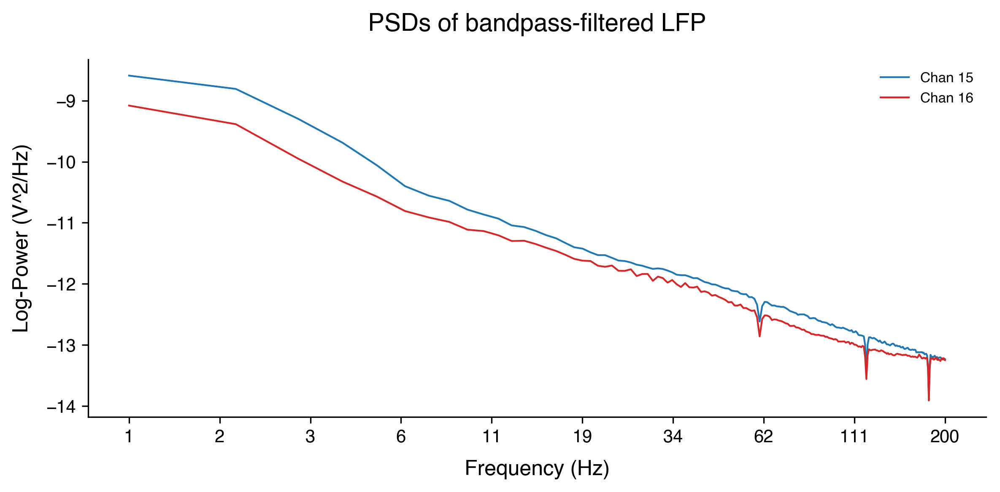

In [195]:
iChan = 14

freq_means1, P_means1 = neurodsp.spectral.psd(lfp_preproc[iChan, :], Fs=2000)
freq_means2, P_means2 = neurodsp.spectral.psd(lfp_preproc[iChan+1, :], Fs=2000)

fig, ax = plt.subplots(1, 1, figsize=(8, 4), dpi=300)
ax = np.ravel(ax)

tickfontsize=10
labelfontsize=12
figfontsize=14

# legend_labs = ['Raw LFP', 'Notch-filtered LFP']
legend_labs = ['Chan {}'.format(iChan+1), 'Chan {}'.format(iChan+2)]

i = 0
ax[i].plot(np.log10(freq_means1[1:201]), np.log10(P_means1[1:201]), label=legend_labs[0])
ax[i].plot(np.log10(freq_means2[1:201]), np.log10(P_means2[1:201]), label=legend_labs[1])
ax[i].set_xticks(np.linspace(np.log10(1), np.log10(200), 10))
ax[i].set_xticklabels([int(round(10**x, 0)) for x in np.linspace(np.log10(1), np.log10(200), 10)])
ax[i].tick_params(labelsize=tickfontsize)
ax[i].set_xlabel('Frequency (Hz)', fontsize=labelfontsize, labelpad=8)
ax[i].set_ylabel('Log-Power (V^2/Hz)', fontsize=labelfontsize, labelpad=8)
ax[i].legend(loc=1, fontsize=tickfontsize, prop={'size': 8}, bbox_to_anchor=[1, 1])
ax[i].set_title('PSDs of bandpass-filtered LFP', fontsize=figfontsize, y=1.05)
fig.tight_layout()

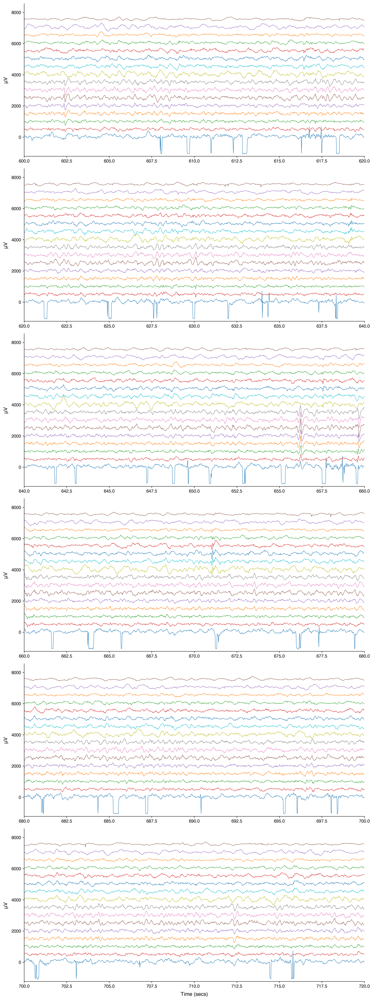

In [200]:
fig, ax = plot_trace2(lfp_preproc, start=600, duration=120, step=40, x_units='secs', create_spread=True, figsize=[12, 32])